# Import packages

In [1]:
import sys
import subprocess
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
from anndata import AnnData
from matplotlib import pyplot as plt
import matplotlib as mpl
import seaborn as sns
import os
import gseapy as gp
from collections import Counter

sys.path.append('../../single_cell_pipeline_output_toolkit_v1')
sys.path.append('../../monkeybread/src')
sys.path.append('../../dendritic_cell_analysis')

from dendritic_cell_analysis import process_single_cell as dca_process
from single_cell_pipeline_output_toolkit_v1 import pipeline_output_toolkit as pot
import monkeybread as mb 
#import volcano

MANY_COLORS = [
    "#0652ff", #  electric blue             
    "#e50000", #  red                       
    "#9a0eea", #  violet                    
    "#01b44c", #  shamrock       
    "#fedf08", #  dandelion                 
    "#00ffff", #  cyan                      
    "#89fe05", #  lime green                
    "#a2cffe", #  baby blue                 
    "#dbb40c", #  gold                      
    "#029386", #  teal                      
    "#ff9408", #  tangerine                 
    "#d8dcd6", #  light grey                
    "#80f9ad", #  seafoam                   
    "#3d1c02", #  chocolate                 
    "#fffd74", #  butter yellow             
    "#536267", #  gunmetal
    "#f6cefc", #  very light purple
    "#650021", #  maroon
    "#020035", #  midnight blue
    "#b0dd16", #  yellowish green
    "#9d7651", #  mocha
    "#c20078", #  magenta
    "#380282", #  indigo
    "#ff796c", #  salmon
    "#874c62", #  dark muave
    "#02ccfe", #  bright sky blue
    "#5fa052", #  muted green
    "#9a3001", #  auburn
    "#fc2647", #  pinky red
    "#d8863b", #  dull orange
    "#7b002c", #  bordeaux
    "#8e82fe", #  periwinkle
    "#ffff14", #  yellow 
    "#ff073a", #  neon red
    "#6ecb3c", #  apple
    "#c45508", #  rust orange
    "#8756e4", #  purpley
    "#8756e4", #  diarrhea
    "#bcecac", #  light sage
    "#5d1451", #  grape purple
    "#028f1e", #  emerald green
    "#ffa62b", #  mango
    "#3a2efe", #  light royal blue
    "#c0022f", #  lipstick red
    "#0485d1", #  cerulean
    "#a57e52", #  puce
    "#380835", #  eggplant
    "#a9f971", #  spring green
    "#fe4b03", #  blood orange
    "#8cff9e", #  baby green
    "#86775f", #  brownish grey
    "#9d0759", #  dark fuchsia
    "#665fd1", #  dark periwinkle
    "#49759c", #  dullblue
    "#fffa86", #  manilla
    "#280137", #  midnight purple
    "#fa4224", #  orangey red
    "#d99b82", #  pinkish tan
    "#152eff", #  vivid blue
    "#f2ab15", #  squash
    "#70b23f", #  nasty green
    "#952e8f", #  warm purple
    "#bcf5a6", #  washed out green
    "#9a6200", #  raw sienna
    "#fb5ffc", #  violet pink
    "#ddd618", #  piss yellow
    "#fe420f", #  orangered
    "#c27e79", #  brownish pink
    "#adf802", #  lemon green
    "#29465b", #  dark grey blue
    "#48c072", #  dark mint
    "#edc8ff"  #  light lilac
]

## Download data from Vizgen

In [2]:
!mkdir -p ./data/vizgen/HumanMelanomaPatient2
!gsutil cp gs://vz-ffpe-showcase/HumanMelanomaPatient2/cell_by_gene.csv ./data/vizgen/HumanMelanomaPatient2
!gsutil cp gs://vz-ffpe-showcase/HumanMelanomaPatient2/cell_metadata.csv ./data/vizgen/HumanMelanomaPatient2

Copying gs://vz-ffpe-showcase/HumanMelanomaPatient2/cell_by_gene.csv...
/ [1 files][438.4 MiB/438.4 MiB]                                                
Operation completed over 1 objects/438.4 MiB.                                    
Copying gs://vz-ffpe-showcase/HumanMelanomaPatient2/cell_metadata.csv...
- [1 files][ 27.4 MiB/ 27.4 MiB]                                                
Operation completed over 1 objects/27.4 MiB.                                     


In [3]:
df_meta = pd.read_csv('./data/vizgen/HumanMelanomaPatient2/cell_metadata.csv', index_col=0)
df_meta

,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y
183932,0,1130.140916,152.274028,6249.049955,142.748725,161.799330,6239.801266,6258.298645
183934,0,138.886608,3.877718,6243.144839,2.109583,5.645852,6240.431482,6245.858195
183935,0,904.852155,202.958029,6247.245333,195.628544,210.287514,6242.523300,6251.967366
183936,0,392.052611,134.961771,6257.559419,129.688256,140.235286,6251.266833,6263.852005
183938,0,179.407528,133.132464,6254.298536,130.274355,135.990574,6251.846677,6256.750394
...,...,...,...,...,...,...,...,...
34219,1180,251.003761,7600.293902,16.622712,7597.543673,7603.044131,13.144266,20.101158
34220,1180,321.750910,7717.710980,35.380081,7714.540597,7720.881363,31.421764,39.338398
34221,1180,540.939982,7581.991590,55.118039,7578.434254,7585.548927,49.298724,60.937353
34222,1180,128.577054,7564.624416,111.726298,7561.956910,7567.291923,109.716782,113.735813


# Load data

In [4]:
# Load expression data
df_expr = pd.read_csv('./data/vizgen/HumanMelanomaPatient2/cell_by_gene.csv', index_col=0)

# Remove blank genes
keep_cols = []
for col in df_expr.columns:
    if not 'Blank' in col:
        keep_cols.append(col)
df_expr = df_expr.loc[:, keep_cols]

df_expr = df_expr.loc[df_meta.index]
adata = AnnData(df_expr)

# Add spatial coordinates
X_spatial = np.array(df_meta[['center_x', 'center_y']])
adata.obsm['X_spatial'] = X_spatial
adata.obs['x'] = adata.obsm['X_spatial'].T[0]
adata.obs['y'] = adata.obsm['X_spatial'].T[1]

# Preserve raw counts as a layer
adata.layers['counts'] = np.array(adata.X)

adata

/mnt/disks/scratch/mbernstein/miniconda3/python3/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 207869 × 500
    obs: 'x', 'y'
    obsm: 'X_spatial'
    layers: 'counts'

In [5]:
adata.var_names_make_unique()
adata.var["mt"] = adata.var_names.str.startswith("mt-")
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt"],
    percent_top=(50, 100, 200, 300),
    inplace=True
)

/mnt/disks/scratch/mbernstein/miniconda3/python3/lib/python3.10/site-packages/scanpy/preprocessing/_qc.py:422: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


## QC and cell filtering

/tmp/ipykernel_24191/2961596687.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(
/tmp/ipykernel_24191/2961596687.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(


<AxesSubplot:xlabel='n_genes_by_counts'>

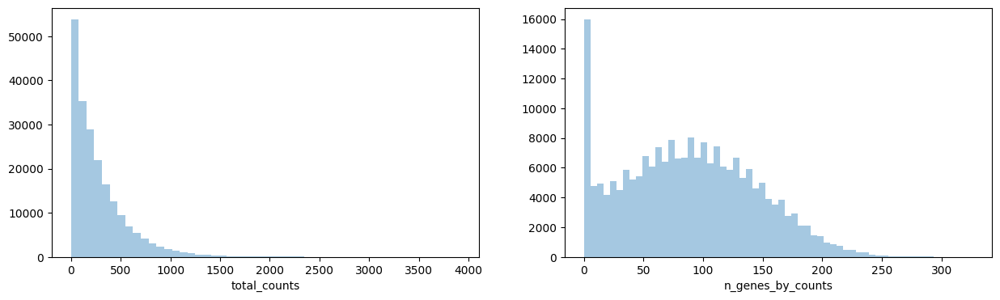

In [6]:
fig, axs = plt.subplots(1, 2, figsize=(15, 4))
sns.distplot(
    adata.obs["total_counts"],
    kde=False,
    ax=axs[0],
)
sns.distplot(
    adata.obs["n_genes_by_counts"],
    kde=False,
    bins=60,
    ax=axs[1],
)

In [7]:
sc.pp.filter_cells(adata, min_counts=10)
sc.pp.filter_genes(adata, min_cells=5)

## Pre-process

In [8]:
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)
sc.pp.pca(adata)
sc.pp.neighbors(adata)

/mnt/disks/scratch/mbernstein/miniconda3/python3/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/mnt/disks/scratch/mbernstein/miniconda3/python3/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/mnt/disks/scratch/mbernstein/miniconda3/p

In [9]:
sc.tl.leiden(adata, resolution=0.3)

In [10]:
sorted(adata.var_names)

['ACKR3',
 'ACTA2',
 'ADAMTS4',
 'AKT1',
 'AKT2',
 'AKT3',
 'AMOTL2',
 'ANGPT1',
 'ANGPT2',
 'APC',
 'ARAF',
 'ARG1',
 'ASCL2',
 'ATF3',
 'ATM',
 'ATR',
 'AURKA',
 'AURKB',
 'AXIN2',
 'BAK1',
 'BAX',
 'BCL2',
 'BCL2L1',
 'BIRC5',
 'BLK',
 'BMI1',
 'BMP1',
 'BRAF',
 'BRCA1',
 'BRD4',
 'BST2',
 'BTLA',
 'BUB1',
 'C1QC',
 'CA7',
 'CA9',
 'CASP8',
 'CAV1',
 'CCL1',
 'CCL11',
 'CCL17',
 'CCL2',
 'CCL22',
 'CCL26',
 'CCL28',
 'CCL3',
 'CCL4',
 'CCL5',
 'CCL7',
 'CCL8',
 'CCNB1',
 'CCND1',
 'CCNE1',
 'CCR1',
 'CCR10',
 'CCR2',
 'CCR3',
 'CCR4',
 'CCR5',
 'CCR6',
 'CCR7',
 'CCR8',
 'CD14',
 'CD160',
 'CD163',
 'CD177',
 'CD19',
 'CD1B',
 'CD1C',
 'CD1E',
 'CD2',
 'CD207',
 'CD209',
 'CD22',
 'CD226',
 'CD244',
 'CD248',
 'CD27',
 'CD274',
 'CD276',
 'CD28',
 'CD3D',
 'CD3E',
 'CD3G',
 'CD4',
 'CD40',
 'CD40LG',
 'CD5',
 'CD68',
 'CD70',
 'CD79A',
 'CD79B',
 'CD80',
 'CD83',
 'CD86',
 'CD8A',
 'CD8B',
 'CDCA7',
 'CDH1',
 'CDH5',
 'CDK2',
 'CDK4',
 'CDK6',
 'CDKN1A',
 'CDKN1B',
 'CEACAM1',
 'CEA

In [11]:
adata.write_h5ad('./output/HumanMelanomaPatient2.h5ad')

# Annotate cell types

In [12]:
adata = anndata.read_h5ad('./output/HumanMelanomaPatient2.h5ad')
adata.uns['log1p']['base'] = None
adata

AnnData object with n_obs × n_vars = 189071 × 500
    obs: 'x', 'y', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_300_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'leiden', 'log1p', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

categories: 0, 1, 2, etc.
var_group_labels: T cell, CD8 T, CD4 T, etc.


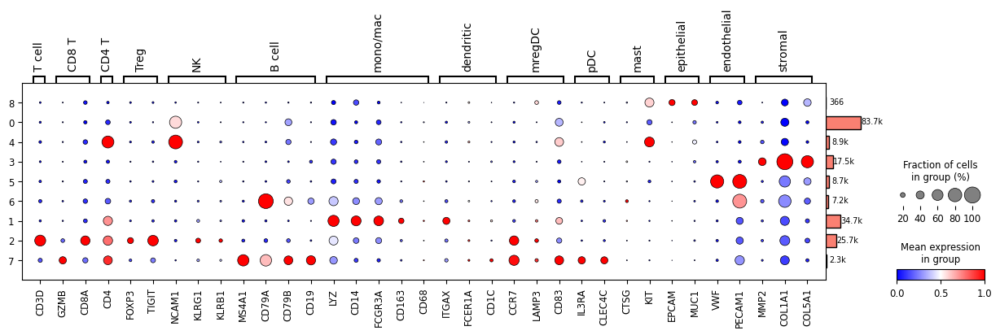

In [13]:
sc.tl.dendrogram(adata, groupby='leiden')
dp = sc.pl.dotplot(
    adata, 
    var_names={
        'T cell': [
            'CD3D'
        ],
        'CD8 T': [
            'GZMB',
            'CD8A'
        ],
        'CD4 T': [
            'CD4'
        ],
        'Treg': [
            'FOXP3', 
            'TIGIT'
        ],
        'NK': [
            'NCAM1',
            'KLRG1',
            'KLRB1'
        ],
        'B cell': [
            'MS4A1',
            'CD79A',
            'CD79B',
            'CD19'
        ],
        'mono/mac': [
            'LYZ', 
            'CD14', 
            'FCGR3A', 
            'CD163',
            'CD68'
        ],
        'dendritic': [
            'ITGAX',
            'FCER1A',
            'CD1C'
        ],
        'mregDC': [
            'CCR7',
            'LAMP3',
            'CD83'
        ],
        'pDC': [
            'IL3RA',
            'CLEC4C'
            #'LILRA4'
            #PLD4  
        ],
        'mast': [
            'CTSG',
            'KIT'
        ],
        'epithelial': [
            'EPCAM',
            'MUC1'
        ],
        'endothelial': [
            'VWF', 
            'PECAM1'
        ],
        'stromal': [
            'MMP2',
            'COL1A1',
            'COL5A1'
        ]
    },
    standard_scale='var',
    cmap='bwr',
    groupby=['leiden'],
    dendrogram=True,
    return_fig=True
)
dp.add_totals().style(dot_edge_color='black', cmap='bwr', dot_edge_lw=0.5).show()


In [14]:
clust_to_de_genes = {}
sc.tl.rank_genes_groups(adata, groupby='leiden', method='t-test')
for clust in sorted(set(adata.obs['leiden'])):
    df_de = sc.get.rank_genes_groups_df(adata, group=clust)
    de_genes = df_de[:25]['names']
    clust_to_de_genes[clust] = de_genes

df_de = pd.DataFrame(
    data=clust_to_de_genes
)
display(df_de)

,0,1,2,3,4,5,6,7,8
0,CDK2,HLA-DRA,TRAC,COL1A1,FGFBP2,PLVAP,XBP1,CIITA,SOX9
1,CTNNB1,C1QC,CD3E,PDGFRB,NCAM1,PECAM1,MZB1,HLA-DRA,EGFR
2,ERBB3,CYBB,ZAP70,COL5A1,HLA-B,COL4A1,POU2AF1,HLA-DPB1,MMP7
3,PKM,CSF1R,CD2,CD248,CTNNB1,VWF,CD79A,CXCR4,TBX3
4,MYC,HLA-DPB1,IL2RB,FGFR1,HLA-C,ENG,PDK1,MS4A1,CEBPB
5,BST2,LYZ,ITGB2,LRP1,KIT,MMRN2,FCRL5,CYBB,ERBB2
6,SOX9,CD14,CD5,SFRP2,SPRY2,CDH5,PECAM1,TNFRSF13C,FZD7
7,LMNA,CIITA,TGFB1,FBLN1,IRF4,TGFBR2,IRF4,CD79A,TCF7L2
8,TEAD1,FCGR3A,CD3D,EGR1,STAT5A,KDR,DERL3,BLK,CX3CL1
9,SNAI2,ITGB2,CXCR4,PDGFRA,CD4,CLEC14A,HLA-B,CD22,LAMB3


## Examine UMAPs

In [15]:
adata_sub = sc.pp.subsample(adata, fraction=1/2, copy=True)
sc.pp.pca(adata_sub)
sc.pp.neighbors(adata_sub)
sc.tl.umap(adata_sub)

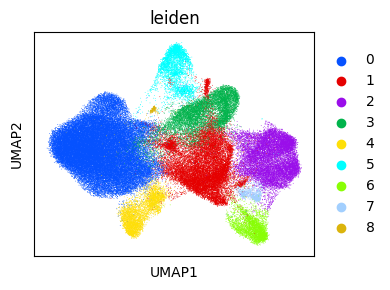

In [16]:
fig, ax = plt.subplots(1,1,figsize=(4,3))
sc.pl.umap(
    adata_sub, 
    color=['leiden'],
    palette=MANY_COLORS,
    ax=ax,
    show=False
)
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_clusters_all_cells_subsampled.png', dpi=200, format='png')

In [17]:
FULL_CLUST_TO_CELL_TYPE = {
    '0': 'malignant',
    '1': 'SUBCLUSTER',
    '2': 'SUBCLUSTER',
    '3': 'stromal',
    '4': 'other',
    '5': 'endothelial',
    '6': 'B lineage',
    '7': 'SUBCLUSTER',
    '8': 'other'
}

categories: 0 (malignant), 1 (SUBCLUSTER), 2 (SUBCLUSTER), etc.
var_group_labels: T cell, CD8 T, CD4 T, etc.


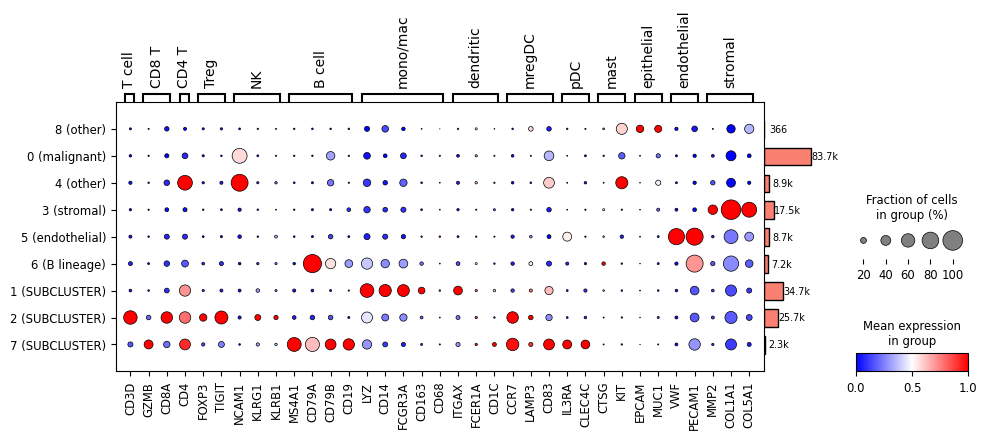

<Figure size 640x480 with 0 Axes>

In [22]:
adata.obs['Cluster'] = [
    f'{clust} ({FULL_CLUST_TO_CELL_TYPE[clust]})'
    for clust in adata.obs['leiden']
]
adata.obs['Cluster'] = adata.obs['Cluster'].astype('category')

sc.tl.dendrogram(adata, groupby='Cluster')
dp = sc.pl.dotplot(
    adata, 
    var_names={
        'T cell': [
            'CD3D'
        ],
        'CD8 T': [
            'GZMB',
            'CD8A'
        ],
        'CD4 T': [
            'CD4'
        ],
        'Treg': [
            'FOXP3', 
            'TIGIT'
        ],
        'NK': [
            'NCAM1',
            'KLRG1',
            'KLRB1'
        ],
        'B cell': [
            'MS4A1',
            'CD79A',
            'CD79B',
            'CD19'
        ],
        'mono/mac': [
            'LYZ', 
            'CD14', 
            'FCGR3A', 
            'CD163',
            'CD68'
        ],
        'dendritic': [
            'ITGAX',
            'FCER1A',
            'CD1C'
        ],
        'mregDC': [
            'CCR7',
            'LAMP3',
            'CD83'
        ],
        'pDC': [
            'IL3RA',
            'CLEC4C'
            #'LILRA4'
            #PLD4  
        ],
        'mast': [
            'CTSG',
            'KIT'
        ],
        'epithelial': [
            'EPCAM',
            'MUC1'
        ],
        'endothelial': [
            'VWF', 
            'PECAM1'
        ],
        'stromal': [
            'MMP2',
            'COL1A1',
            'COL5A1'
        ]
    },
    standard_scale='var',
    cmap='bwr',
    groupby=['Cluster'],
    figsize=(11,3.5),
    dendrogram=True,
    return_fig=True
)
dp.add_totals().style(dot_edge_color='black', cmap='bwr', dot_edge_lw=0.5).show()
plt.tight_layout()
dp.fig.savefig(
    './output/publication_figures/dotplot_clusters_all_cells_subsampled.png', 
    dpi=200, format='png', bbox_inches='tight'
)


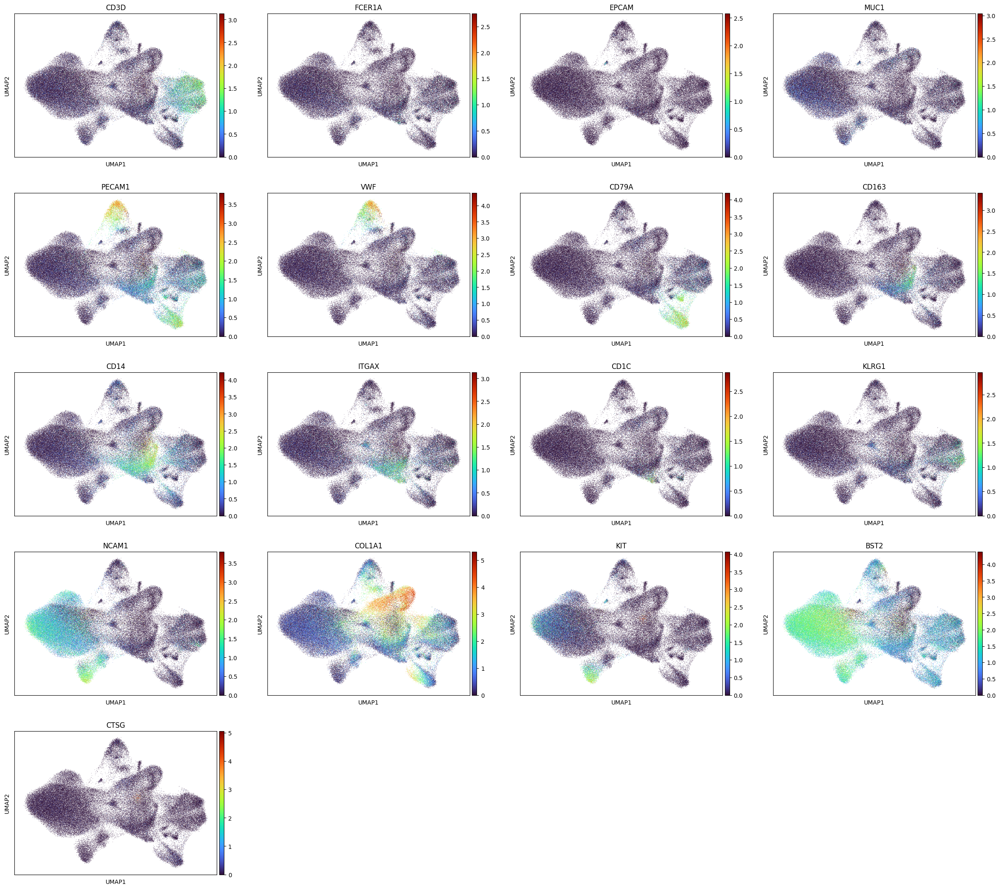

In [23]:
sc.pl.umap(
    adata_sub, 
    color=[
        'CD3D', 'FCER1A', 'EPCAM', 'MUC1', 'PECAM1', 
        'VWF', 'CD79A', 'CD163', 'CD14', 'ITGAX', 'CD1C',
        'KLRG1', 'NCAM1', 'COL1A1', 'KIT', 'BST2', 'CTSG'
    ], 
    cmap='turbo'
)

## Explore Cluster 2 (T cell enriched)

In [24]:
adata_clust_2 = adata[adata.obs['leiden'] == '2']
sc.pp.pca(adata_clust_2)
sc.pp.neighbors(adata_clust_2)
sc.tl.umap(adata_clust_2)
sc.tl.leiden(adata_clust_2, resolution=1.)

In [25]:
clust_to_de_genes = {}
sc.tl.rank_genes_groups(adata_clust_2, groupby='leiden', method='t-test')
for clust in sorted(set(adata_clust_2.obs['leiden'])):
    df_de = sc.get.rank_genes_groups_df(adata_clust_2, group=clust)
    de_genes = df_de[:25]['names']
    clust_to_de_genes[clust] = de_genes

df_de = pd.DataFrame(
    data=clust_to_de_genes
)
display(df_de)

,0,1,10,11,2,3,4,5,6,7,8,9
0,CCR7,CCL5,CTNNB1,XBP1,HLA-DRA,FOXP3,CD8A,PDCD1,COL1A1,COL1A1,GNLY,HLA-DRA
1,KLF2,CD8A,PKM,MZB1,C1QC,CTLA4,NKG7,CD4,FN1,FN1,IL2RB,C1QC
2,CD5,CXCR4,CDK2,POU2AF1,LYZ,IKZF2,PDCD1,CD2,LRP1,LRP1,CTSW,FOXP3
3,IL6R,KLRK1,LMNA,CD79A,HLA-DPB1,IL2RA,HAVCR2,PKM,PDGFRB,PDGFRB,NCR1,FCGR3A
4,ETS1,GZMK,CCND1,IRF4,CYBB,TIGIT,LAG3,TRAC,CD248,COL5A1,NKG7,HLA-DRB1
5,CD40LG,NKG7,BST2,PECAM1,HLA-DRB1,TRAC,CCL5,TNFRSF4,CD8A,CD248,SH2D1B,CD14
6,TRAC,KLRG1,WWTR1,PDK1,MMP9,CCR4,CTSW,CD40LG,COL5A1,SFRP2,NCAM1,CYBB
7,CD3E,EOMES,YAP1,FCRL5,CD14,CSF1,TNFRSF9,IL6R,CCL5,FGFR1,ITGAM,LYZ
8,ZAP70,CTSW,SOX9,DERL3,FCGR3A,TNFRSF18,GZMH,TNFRSF18,SFRP2,PDGFRA,PRF1,HLA-DPB1
9,CXCR4,GZMA,TEAD1,HLA-B,CSF1R,IL2RB,KLRK1,ZAP70,FBLN1,FBLN1,KLRK1,CSF1R


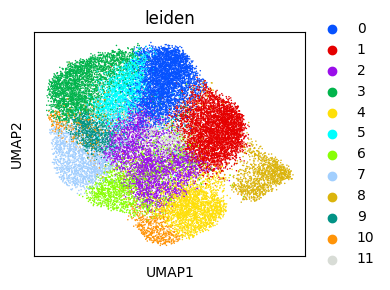

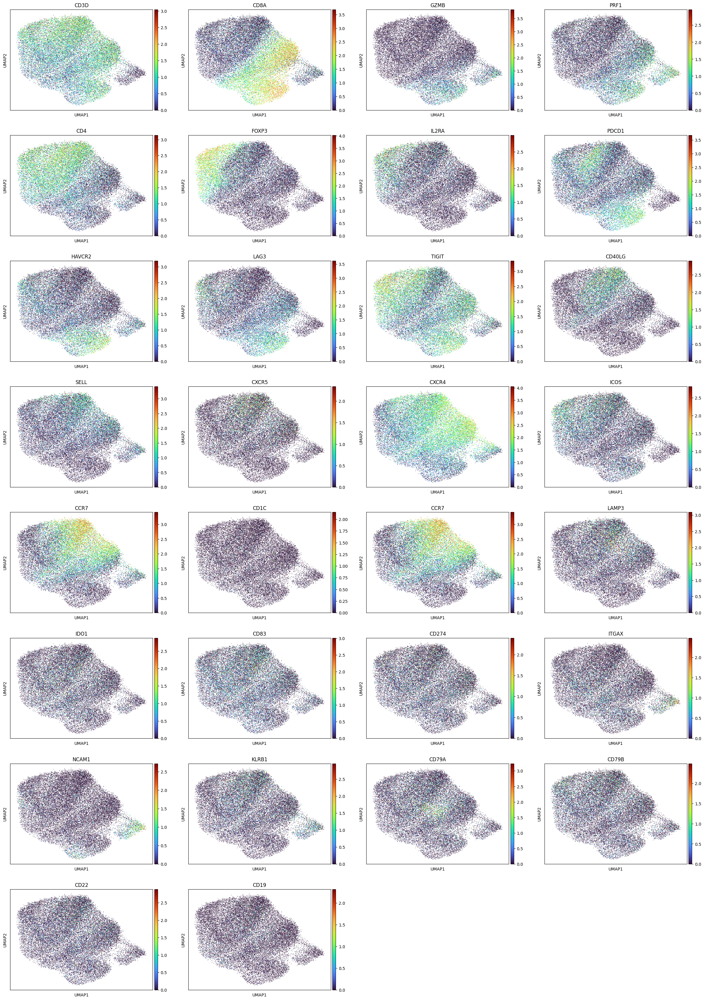

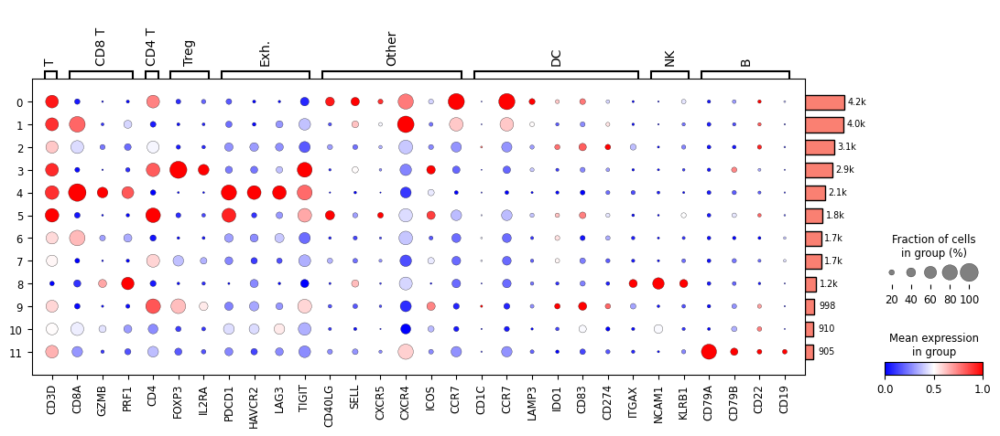

In [26]:
fig, ax = plt.subplots(1,1,figsize=(4,3))
sc.pl.umap(
    adata_clust_2, 
    color=['leiden'],
    palette=MANY_COLORS,
    ax=ax,
    show=False
)
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_clusters_C2.png', dpi=200, format='png')

PLOT_GENES = {
    'T': ['CD3D'], 
    'CD8 T': ['CD8A', 'GZMB', 'PRF1'],
    'CD4 T': ['CD4'], 
    'Treg': ['FOXP3', 'IL2RA'],
    'Exh.': ['PDCD1', 'HAVCR2', 'LAG3', 'TIGIT'],
    'Other': ['CD40LG', 'SELL', 'CXCR5', 'CXCR4', 'ICOS', 'CCR7'], 
    'DC': ['CD1C', 'CCR7', 'LAMP3', 'IDO1', 'CD83', 'CD274', 'ITGAX'],
    'NK': ['NCAM1', 'KLRB1'],
    'B': ['CD79A', 'CD79B', 'CD22', 'CD19']
}

# UMAP plots of all genes
plot_genes = []
for genes in PLOT_GENES.values():
    plot_genes += genes
sc.pl.umap(
    adata_clust_2, 
    color=plot_genes,
    cmap='turbo',
    show=True
)


sc.tl.dendrogram(adata_clust_2, groupby='leiden')
dp = sc.pl.dotplot(
    adata_clust_2, 
    var_names=PLOT_GENES, 
    groupby='leiden', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()

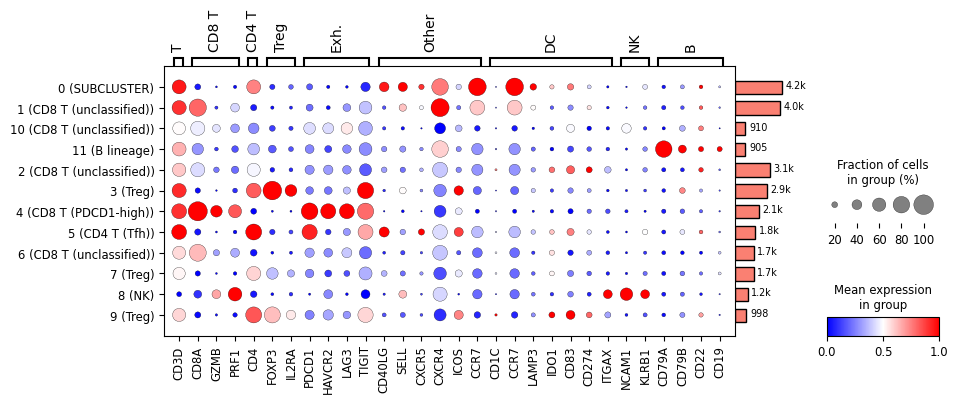

<Figure size 640x480 with 0 Axes>

In [28]:
CLUST2_CLUST_TO_CELL_TYPE = {
    '0': 'SUBCLUSTER', 
    '1': 'CD8 T',
    '2': 'CD8 T',
    '3': 'Treg',
    '4': 'CD8 T',
    '5': 'CD4 T',
    '6': 'CD8 T',
    '7': 'Treg',
    '8': 'NK',
    '9': 'Treg',
    '10': 'CD8 T',
    '11': 'B lineage'
}

CLUST2_CLUST_TO_CELL_SUBTYPE = {
    '0': 'SUBCLUSTER', 
    '1': 'CD8 T (unclassified)',
    '2': 'CD8 T (unclassified)',
    '3': 'Treg', 
    '4': 'CD8 T (PDCD1-high)',
    '5': 'CD4 T (Tfh)',
    '6': 'CD8 T (unclassified)',
    '7': 'Treg',
    '8': 'NK',
    '9': 'Treg',
    '10': 'CD8 T (unclassified)',
    '11': 'B lineage'
}

adata_clust_2.obs['Cluster'] = [
    f'{clust} ({CLUST2_CLUST_TO_CELL_SUBTYPE[clust]})'
    for clust in adata_clust_2.obs['leiden']
]
adata_clust_2.obs['Cluster'] = adata_clust_2.obs['Cluster'].astype('category')

sc.tl.dendrogram(adata_clust_2, groupby='Cluster')
dp = sc.pl.dotplot(
    adata_clust_2, 
    var_names=PLOT_GENES, 
    groupby='Cluster', 
    standard_scale='var',
    cmap='bwr',
    figsize=(10,3.5),
    return_fig=True
)
dp.add_totals().show()
plt.tight_layout()
dp.fig.savefig(
    './output/publication_figures/dotplot_clusters_C2.png', 
    dpi=200, format='png', bbox_inches='tight'
)

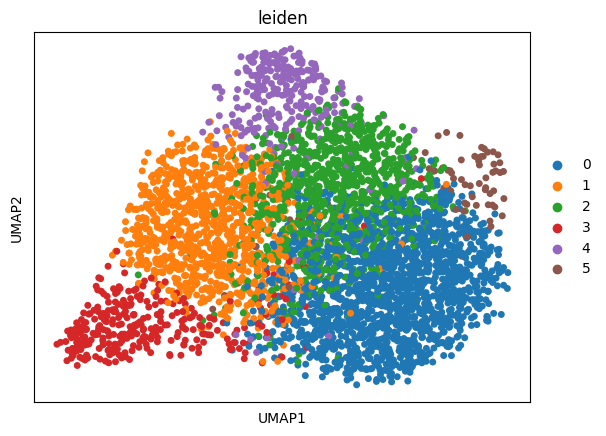

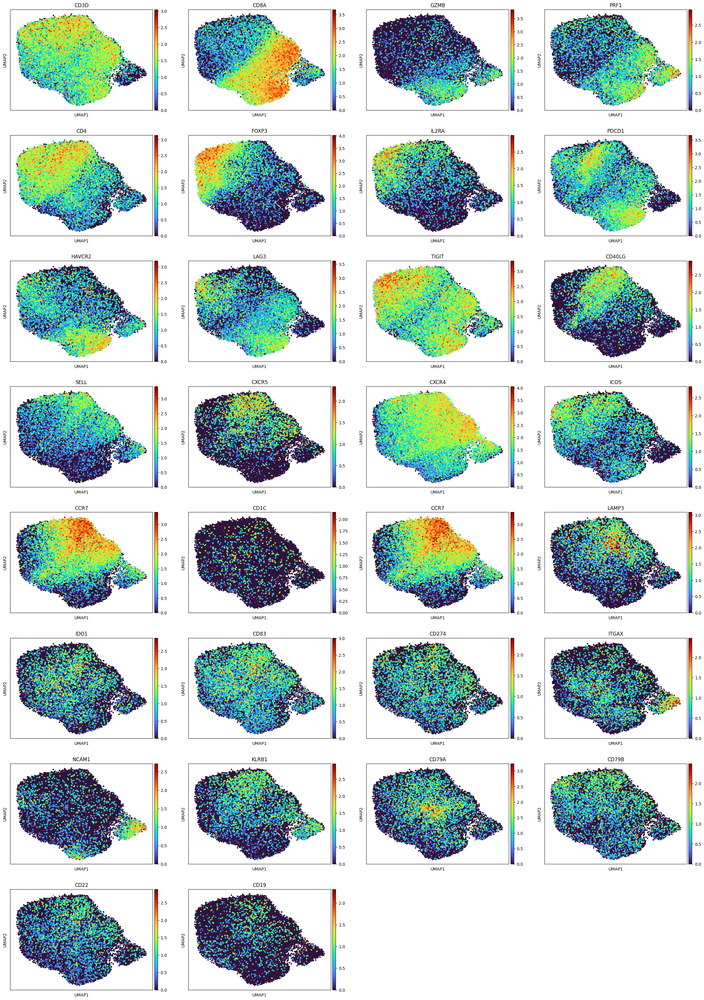

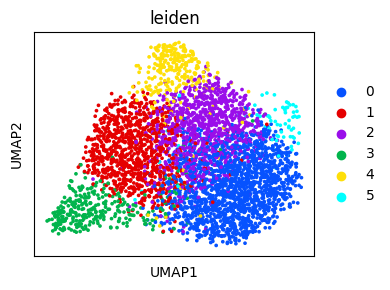

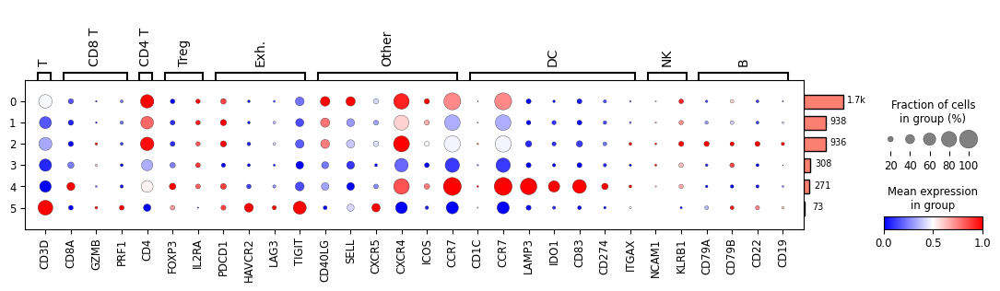

,0,1,2,3,4,5
0,ZAP70,COL1A1,HLA-DRA,ENG,LAMP3,CD27
1,CCR7,CXCL9,HLA-DPB1,PLVAP,CDKN1A,CD3E
2,TRAC,SOD2,LYZ,VWF,CD83,TIGIT
3,CD28,FN1,HLA-DRB1,PECAM1,HLA-DPB1,HAVCR2
4,CD2,LRP1,CIITA,COL4A1,CCR7,EOMES
5,KLF2,PDGFRB,CYBB,MMRN2,IDO1,KLRK1
6,CD3E,CXCL12,CD79A,TGFBR2,HLA-DRA,CD3D
7,ETS1,CD248,HLA-DMA,CDH5,CSF2RA,POU2AF1
8,CD5,EGR1,MS4A1,KDR,IRF4,FGFR1
9,GATA3,VCAM1,C1QC,CLEC14A,CD40,PECAM1


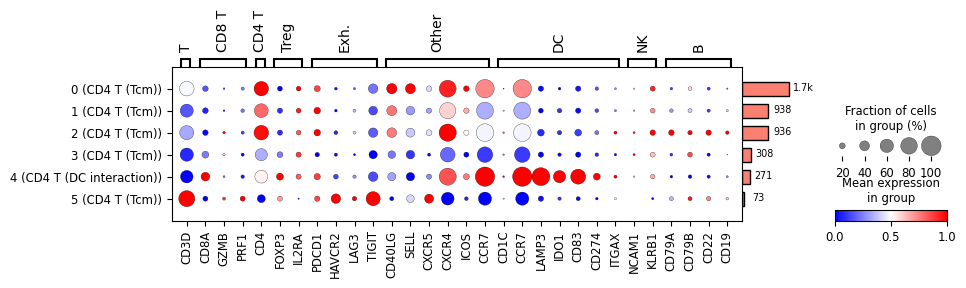

<Figure size 640x480 with 0 Axes>

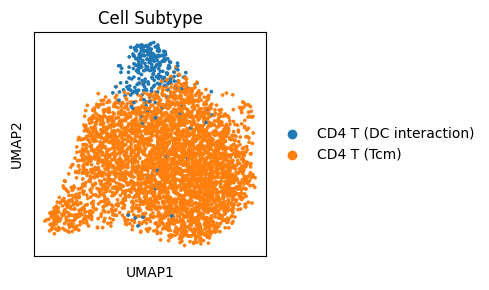

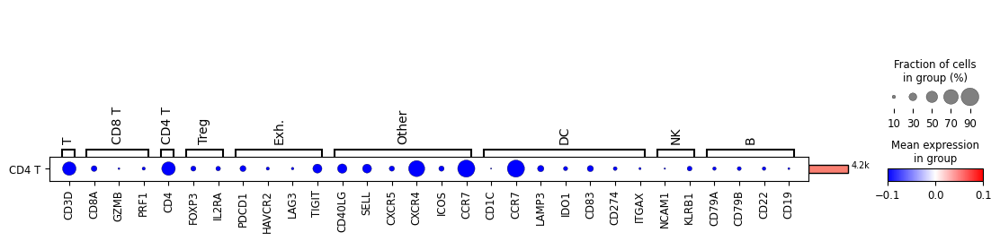

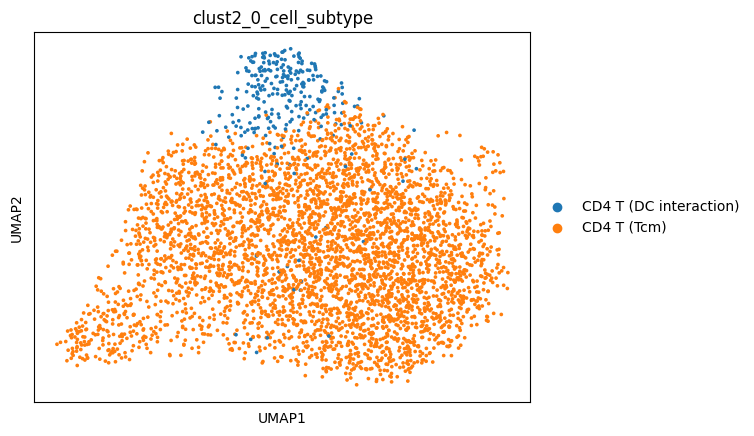

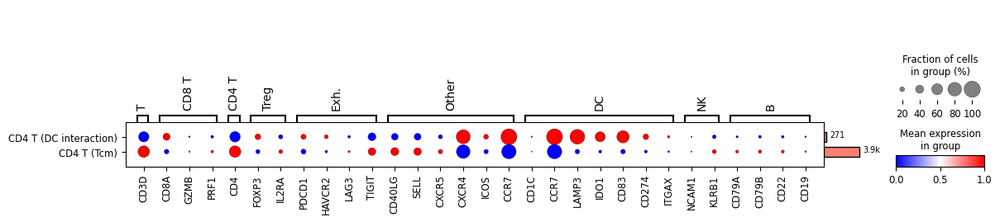

In [39]:
adata_clust_2_0 = adata_clust_2[adata_clust_2.obs['leiden'] == '0']
sc.pp.pca(adata_clust_2_0)
sc.pp.neighbors(adata_clust_2_0)
sc.tl.umap(adata_clust_2_0)
sc.tl.leiden(adata_clust_2_0, resolution=0.75)

sc.pl.umap(adata_clust_2_0, color='leiden', s=100)

PLOT_GENES = {
    'T': ['CD3D'], 
    'CD8 T': ['CD8A', 'GZMB', 'PRF1'],
    'CD4 T': ['CD4'], 
    'Treg': ['FOXP3', 'IL2RA'],
    'Exh.': ['PDCD1', 'HAVCR2', 'LAG3', 'TIGIT'],
    'Other': ['CD40LG', 'SELL', 'CXCR5', 'CXCR4', 'ICOS', 'CCR7'], 
    'DC': ['CD1C', 'CCR7', 'LAMP3', 'IDO1', 'CD83', 'CD274', 'ITGAX'],
    'NK': ['NCAM1', 'KLRB1'],
    'B': ['CD79A', 'CD79B', 'CD22', 'CD19']
}

plot_genes = []
for genes in PLOT_GENES.values():
    plot_genes += genes
sc.pl.umap(
    adata_clust_2, 
    color=plot_genes,
    cmap='turbo',
    s=50,
    show=True
)

fig, ax = plt.subplots(1,1,figsize=(4,3))
sc.pl.umap(
    adata_clust_2_0, 
    color=['leiden'],
    palette=MANY_COLORS,
    ax=ax,
    show=False
)
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_clusters_C2_0.png', dpi=200, format='png')


dp = sc.pl.dotplot(
    adata_clust_2_0, 
    var_names=PLOT_GENES, 
    groupby='leiden', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()

clust_to_de_genes = {}
sc.tl.rank_genes_groups(adata_clust_2_0, groupby='leiden', method='t-test')
for clust in sorted(set(adata_clust_2_0.obs['leiden'])):
    df_de = sc.get.rank_genes_groups_df(adata_clust_2_0, group=clust)
    de_genes = df_de[:25]['names']
    clust_to_de_genes[clust] = de_genes

df_de = pd.DataFrame(
    data=clust_to_de_genes
)
display(df_de)

CLUST2_0_CLUST_TO_CELL_TYPE = {
    '0': 'CD4 T', 
    '1': 'CD4 T',
    '2': 'CD4 T',
    '3': 'CD4 T',
    '4': 'CD4 T',
    '5': 'CD4 T'
}

CLUST2_0_CLUST_TO_CELL_SUBTYPE = {
    '0': 'CD4 T (Tcm)', 
    '1': 'CD4 T (Tcm)',
    '2': 'CD4 T (Tcm)',
    '3': 'CD4 T (Tcm)', 
    '4': 'CD4 T (DC interaction)',
    '5': 'CD4 T (Tcm)'
}

# Create dotplot with renamed clusters
adata_clust_2_0.obs['Cluster'] = [
    f'{clust} ({CLUST2_0_CLUST_TO_CELL_SUBTYPE[clust]})'
    for clust in adata_clust_2_0.obs['leiden']
]
adata_clust_2_0.obs['Cluster'] = adata_clust_2_0.obs['Cluster'].astype('category')
sc.tl.dendrogram(adata_clust_2_0, groupby='Cluster')
dp = sc.pl.dotplot(
    adata_clust_2_0, 
    var_names=PLOT_GENES, 
    groupby='Cluster', 
    standard_scale='var',
    cmap='bwr',
    figsize=(10,2),
    return_fig=True
)
dp.add_totals().show()
plt.tight_layout()
dp.fig.savefig(
    './output/publication_figures/dotplot_clusters_C2_0.png', 
    dpi=200, format='png', bbox_inches='tight'
)


clust2_0_cell_to_cell_type = {
    cell: CLUST2_0_CLUST_TO_CELL_TYPE[clust]
    for cell, clust in zip(adata_clust_2_0.obs.index, adata_clust_2_0.obs['leiden'])
}
clust2_0_cell_to_cell_subtype = {
    cell: CLUST2_0_CLUST_TO_CELL_SUBTYPE[clust]
    for cell, clust in zip(adata_clust_2_0.obs.index, adata_clust_2_0.obs['leiden'])
}

adata_clust_2_0.obs['clust2_0_cell_type'] = [
    clust2_0_cell_to_cell_type[cell]
    for cell in adata_clust_2_0.obs.index
]
adata_clust_2_0.obs['clust2_0_cell_subtype'] = [
    clust2_0_cell_to_cell_subtype[cell]
    for cell in adata_clust_2_0.obs.index
]


fig, ax = plt.subplots(1,1,figsize=(5,3))
sc.pl.umap(
    adata_clust_2_0, 
    color=['clust2_0_cell_subtype'],
    ax=ax,
    show=False
)
ax.set_title('Cell Subtype')
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_subtype_C2_0.png', dpi=200, format='png')

dp = sc.pl.dotplot(
    adata_clust_2_0, 
    var_names=PLOT_GENES, 
    groupby='clust2_0_cell_type', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()


sc.pl.umap(adata_clust_2_0, color='clust2_0_cell_subtype')
dp = sc.pl.dotplot(
    adata_clust_2_0, 
    var_names=PLOT_GENES, 
    groupby='clust2_0_cell_subtype', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()

### Perform final annotation of Cluster 2

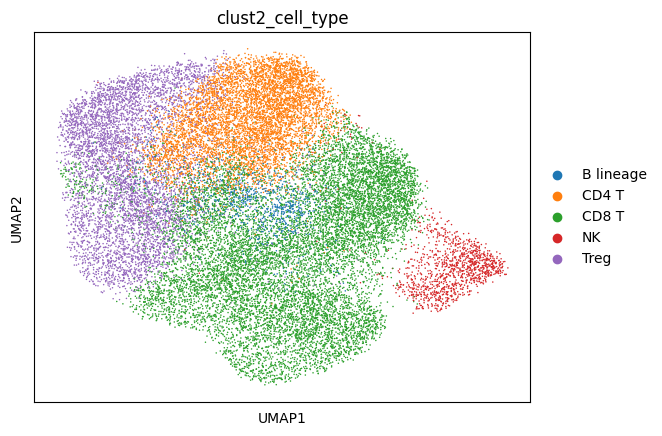

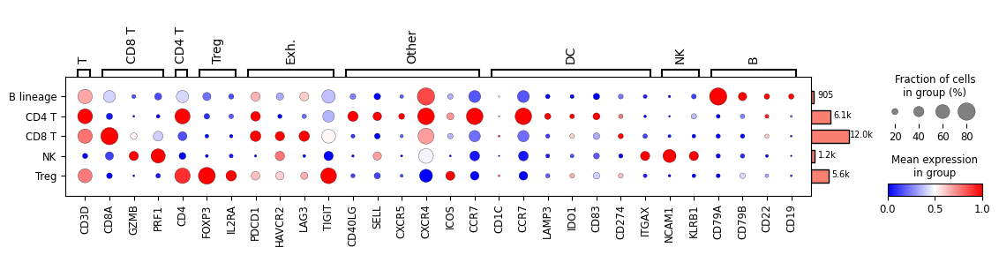

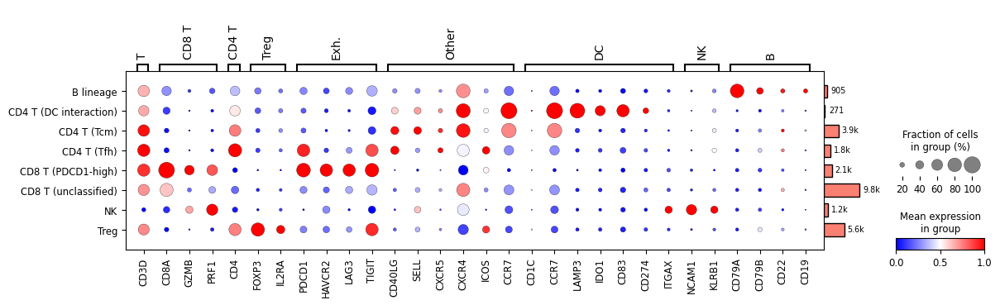

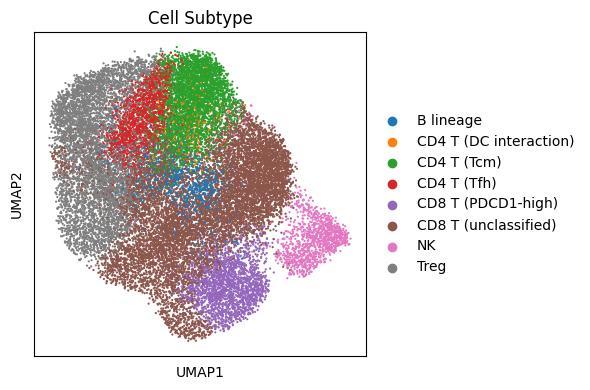

In [43]:
clust2_cell_to_cell_type = {}
labels = []
for cell, clust in zip(adata_clust_2.obs.index, adata_clust_2.obs['leiden']):
    if cell in clust2_0_cell_to_cell_type:
        labels.append(clust2_0_cell_to_cell_type[cell])
        clust2_cell_to_cell_type[cell] = clust2_0_cell_to_cell_type[cell]
    else:
        labels.append(CLUST2_CLUST_TO_CELL_TYPE[clust])
        clust2_cell_to_cell_type[cell] = CLUST2_CLUST_TO_CELL_TYPE[clust]
adata_clust_2.obs['clust2_cell_type'] = labels


clust2_cell_to_cell_subtype = {}
labels = []
for cell, clust in zip(adata_clust_2.obs.index, adata_clust_2.obs['leiden']):
    if cell in clust2_0_cell_to_cell_subtype:
        labels.append(clust2_0_cell_to_cell_subtype[cell])
        clust2_cell_to_cell_subtype[cell] = clust2_0_cell_to_cell_subtype[cell]
    else:
        labels.append(CLUST2_CLUST_TO_CELL_SUBTYPE[clust])
        clust2_cell_to_cell_subtype[cell] = CLUST2_CLUST_TO_CELL_SUBTYPE[clust]
adata_clust_2.obs['clust2_cell_subtype'] = labels


sc.pl.umap(adata_clust_2, color='clust2_cell_type')
dp = sc.pl.dotplot(
    adata_clust_2, 
    var_names=PLOT_GENES, 
    groupby='clust2_cell_type', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()


dp = sc.pl.dotplot(
    adata_clust_2, 
    var_names=PLOT_GENES, 
    groupby='clust2_cell_subtype', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()

fig, ax = plt.subplots(1,1,figsize=(6,4))
sc.pl.umap(
    adata_clust_2, 
    color=['clust2_cell_subtype'],
    ax=ax,
    s=10,
    show=False
)
ax.set_title('Cell Subtype')
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_subtype_C2.png', dpi=200, format='png')

## Explore Cluster 1 (myeloid)

In [44]:
adata_clust_1 = adata[adata.obs['leiden'] == '1']
sc.pp.pca(adata_clust_1)
sc.pp.neighbors(adata_clust_1)
sc.tl.umap(adata_clust_1)
sc.tl.leiden(adata_clust_1, resolution=1.25)

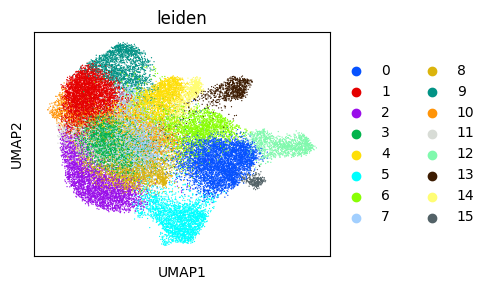

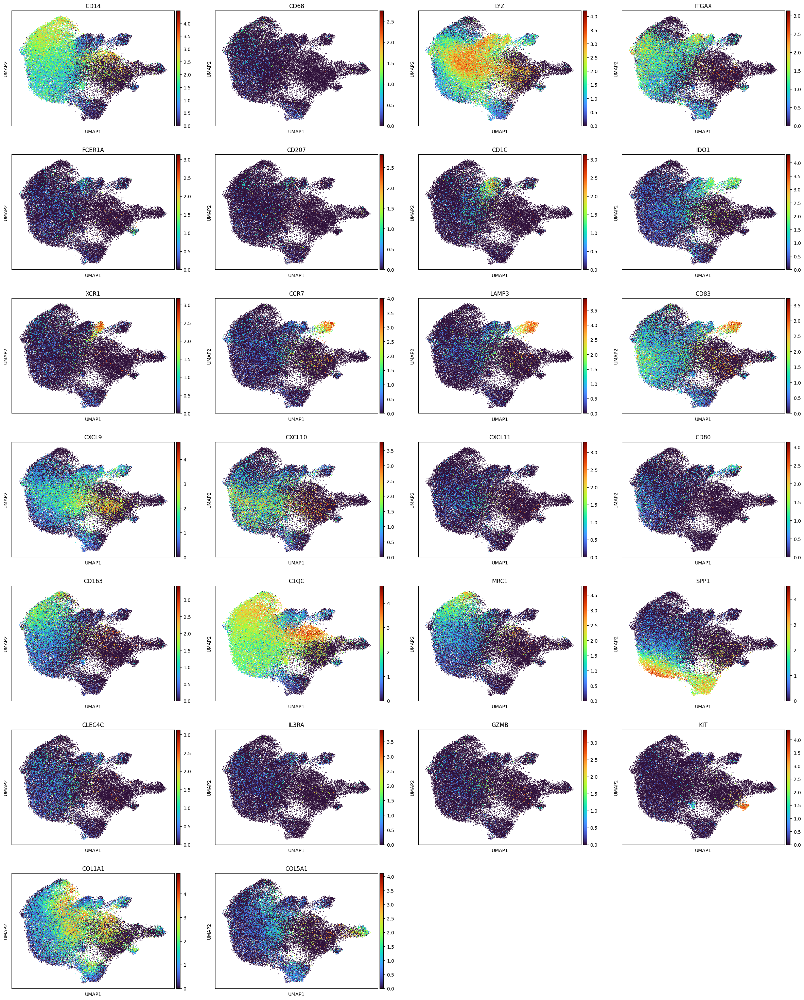

categories: 0, 1, 2, etc.
var_group_labels: mono/mac, cDC2, cDC1, etc.


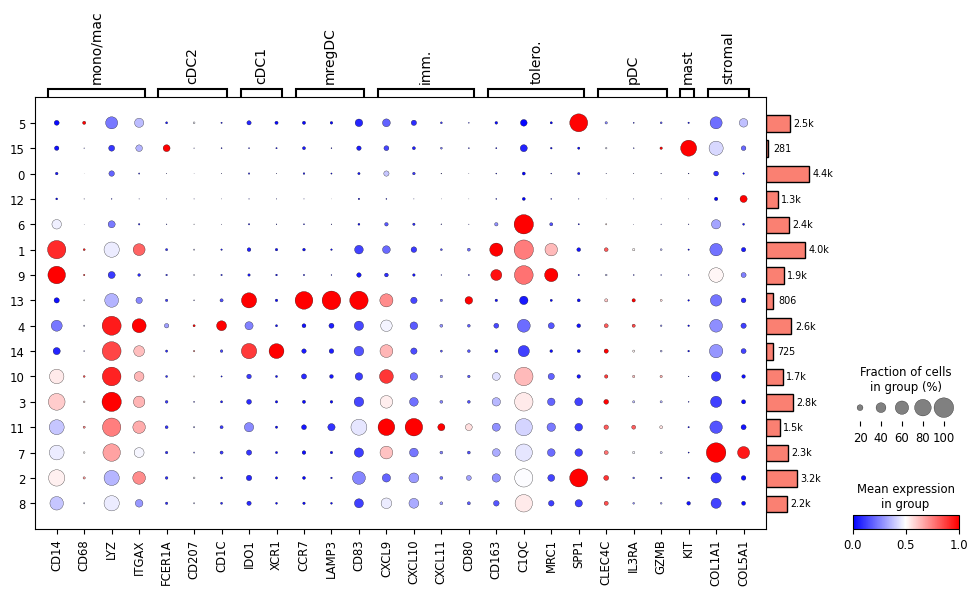

,0,1,10,11,12,13,14,15,2,3,4,5,6,7,8,9
0,PKM,CSF1R,LYZ,CXCL10,GPX3,LAMP3,XCR1,CTSG,SPP1,FN1,CIITA,MMP9,C1QC,COL1A1,CTNNB1,CD14
1,CXCL5,CD14,MMP9,ICAM1,LRP1,CCR7,IDO1,KIT,FN1,LYZ,LYZ,SPP1,HLA-DRA,FN1,CDK2,CSF1R
2,PRTN3,MAFB,CXCL9,IL4I1,CAV1,CD83,HLA-DPB1,HLA-B,FCGR3A,ITGB2,HLA-DPB1,PKM,HLA-B,COL5A1,BST2,C1QC
3,MMP7,CIITA,HLA-DRA,CD40,COL4A1,CDKN1A,HLA-DRB1,TGFB1,CTNNB1,SERPINA1,HLA-DRA,SRC,HLA-DPB1,PDGFRB,PKM,LRP1
4,LAMC2,C1QC,C1QC,NFKBIA,LRP5,IDO1,HLA-DRA,HLA-C,TREM2,CYBB,HLA-DRB1,MYC,COL1A1,CD248,CCND1,FOS
5,KLRF1,HLA-DMA,HLA-DPB1,CD83,TMEM37,CSF2RA,CCND1,CD22,PKM,HLA-DRA,ITGB2,TNFRSF13B,CXCL5,LYZ,FCGR3A,MRC1
6,CCL26,SIGLEC1,CYBB,CXCL9,CD248,NFKB2,TAP2,CSF1,CCL2,MMP9,HLA-DMA,ENG,KLRF1,FGFR1,WWTR1,NRP1
7,PGLYRP1,LRP1,MAFB,SOD2,YAP1,IRF4,THBD,BST2,JUN,MARCO,FOS,ITGA5,PRTN3,SOD2,ETS1,SIGLEC1
8,TBX10,CD163,HLA-DRB1,NFKB2,AMOTL2,CD40,ICAM3,TAPBP,CD276,IL4I1,CD1C,EPHB3,MMP7,MMP1,HLA-C,GPX3
9,ANGPT2,CMKLR1,IL4I1,CD274,EGFR,CXCR4,LYZ,PRKCA,TGFBI,CD14,SERPINA1,ITGB1,TBX10,PDGFRA,FN1,CXCL12


In [50]:
fig, ax = plt.subplots(1,1,figsize=(5,3))
sc.pl.umap(
    adata_clust_1, 
    color=['leiden'],
    palette=MANY_COLORS,
    ax=ax,
    show=False
)
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_clusters_C1.png', dpi=200, format='png')


PLOT_GENES = {
    'mono/mac': ['CD14', 'CD68', 'LYZ', 'ITGAX'], 
    'cDC2': ['FCER1A', 'CD207', 'CD1C'],
    'cDC1': ['IDO1', 'XCR1'],
    'mregDC': ['CCR7', 'LAMP3', 'CD83'],
    'imm.': ['CXCL9', 'CXCL10', 'CXCL11', 'CD80'],
    'tolero.': ['CD163', 'C1QC', 'MRC1', 'SPP1'],
    'pDC': ['CLEC4C', 'IL3RA', 'GZMB'],
    'mast': ['KIT'],
    'stromal': ['COL1A1', 'COL5A1']
}
plot_genes = []
for genes in PLOT_GENES.values():
    plot_genes += genes
sc.pl.umap(adata_clust_1, color=plot_genes, cmap='turbo', s=10)

sc.tl.dendrogram(adata_clust_1, groupby='leiden')
dp = sc.pl.dotplot(
    adata_clust_1, 
    var_names=PLOT_GENES, 
    groupby='leiden', 
    dendrogram=True,
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()


clust_to_de_genes = {}
sc.tl.rank_genes_groups(adata_clust_1, groupby='leiden', method='wilcoxon')
for clust in sorted(set(adata_clust_1.obs['leiden'])):
    df_de = sc.get.rank_genes_groups_df(adata_clust_1, group=clust)
    de_genes = df_de[:25]['names']
    clust_to_de_genes[clust] = de_genes

df_de = pd.DataFrame(
    data=clust_to_de_genes
)
display(df_de)

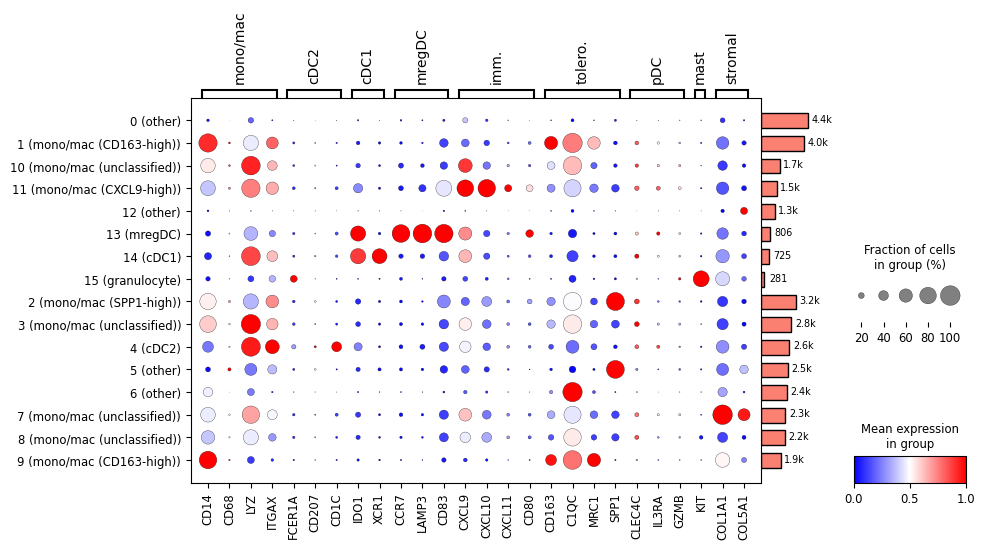

<Figure size 640x480 with 0 Axes>

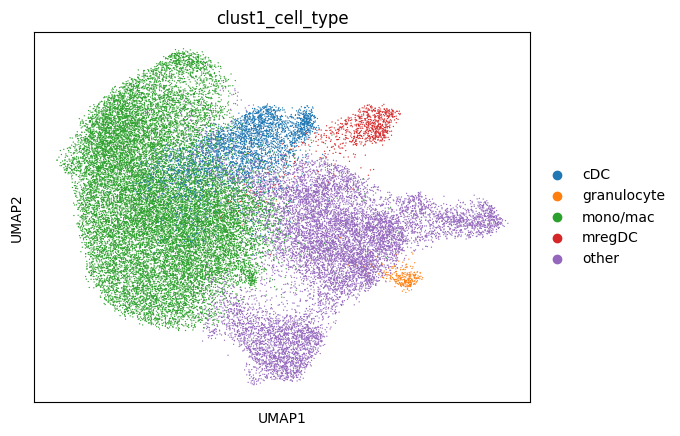

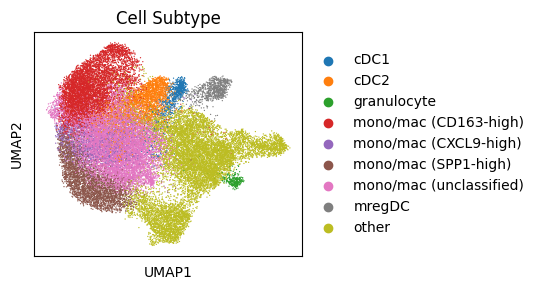

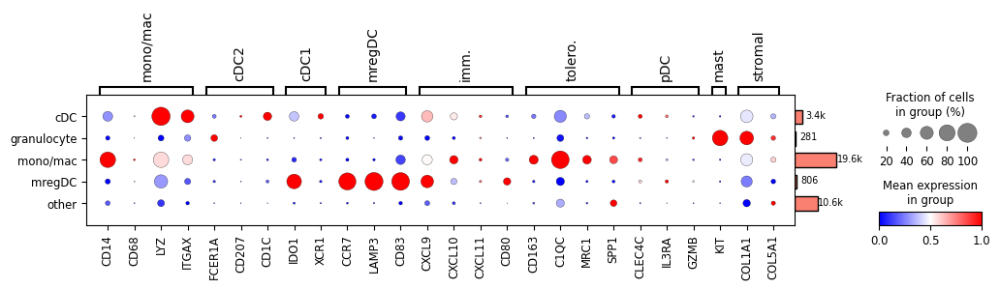

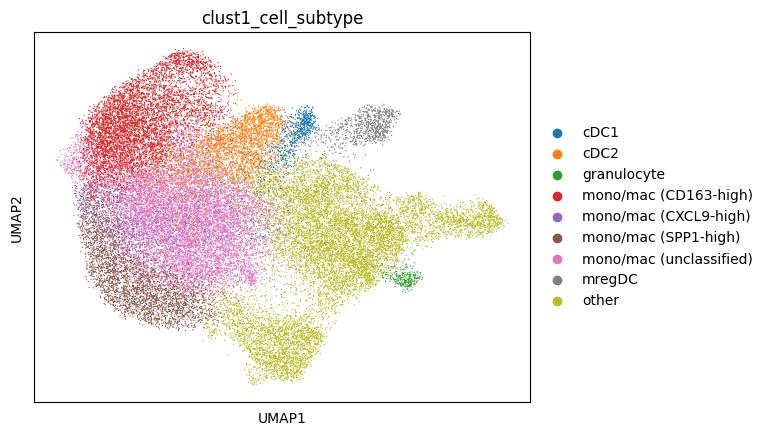

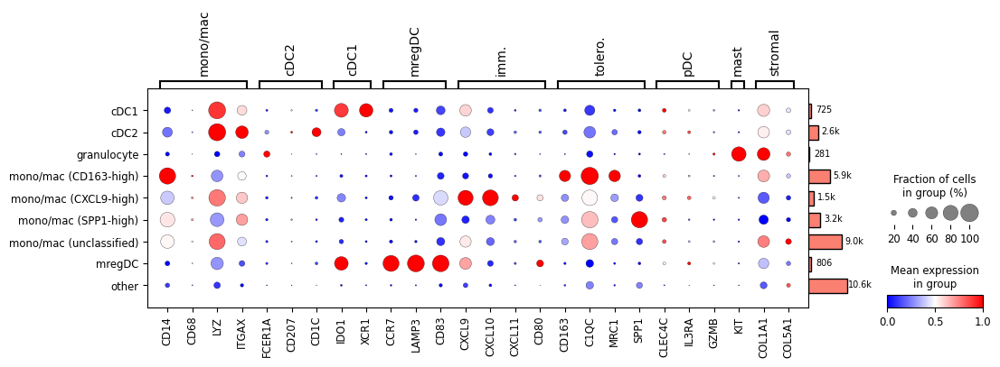

In [52]:
CLUST1_CLUST_TO_CELL_TYPE = {
    '0': 'other', 
    '1': 'mono/mac',
    '2': 'mono/mac',
    '3': 'mono/mac',
    '4': 'cDC',
    '5': 'other',
    '6': 'other',
    '7': 'mono/mac',
    '8': 'mono/mac',
    '9': 'mono/mac',
    '10': 'mono/mac',
    '11': 'mono/mac',
    '12': 'other',
    '13': 'mregDC',
    '14': 'cDC',
    '15': 'granulocyte'
}

CLUST1_CLUST_TO_CELL_SUBTYPE = {
    '0': 'other', 
    '1': 'mono/mac (CD163-high)',
    '2': 'mono/mac (SPP1-high)',
    '3': 'mono/mac (unclassified)',
    '4': 'cDC2',
    '5': 'other',
    '6': 'other',
    '7': 'mono/mac (unclassified)',
    '8': 'mono/mac (unclassified)',
    '9': 'mono/mac (CD163-high)',
    '10': 'mono/mac (unclassified)',
    '11': 'mono/mac (CXCL9-high)',
    '12': 'other',
    '13': 'mregDC',
    '14': 'cDC1',
    '15': 'granulocyte'
}


# Create dotplot with renamed clusters
adata_clust_1.obs['Cluster'] = [
    f'{clust} ({CLUST1_CLUST_TO_CELL_SUBTYPE[clust]})'
    for clust in adata_clust_1.obs['leiden']
]
adata_clust_1.obs['Cluster'] = adata_clust_1.obs['Cluster'].astype('category')
sc.tl.dendrogram(adata_clust_1, groupby='Cluster')
dp = sc.pl.dotplot(
    adata_clust_1, 
    var_names=PLOT_GENES, 
    groupby='Cluster', 
    standard_scale='var',
    cmap='bwr',
    figsize=(10,5),
    return_fig=True
)
dp.add_totals().show()
plt.tight_layout()
dp.fig.savefig(
    './output/publication_figures/dotplot_clusters_C1.png', 
    dpi=200, format='png', bbox_inches='tight'
)

clust1_cell_to_cell_type = {
    cell: CLUST1_CLUST_TO_CELL_TYPE[clust]
    for cell, clust in zip(adata_clust_1.obs.index, adata_clust_1.obs['leiden'])
}
clust1_cell_to_cell_subtype = {
    cell: CLUST1_CLUST_TO_CELL_SUBTYPE[clust]
    for cell, clust in zip(adata_clust_1.obs.index, adata_clust_1.obs['leiden'])
}

adata_clust_1.obs['clust1_cell_type'] = [
    clust1_cell_to_cell_type[cell]
    for cell in adata_clust_1.obs.index
]
adata_clust_1.obs['clust1_cell_subtype'] = [
    clust1_cell_to_cell_subtype[cell]
    for cell in adata_clust_1.obs.index
]

sc.pl.umap(
    adata_clust_1, 
    color=['clust1_cell_type']
)

fig, ax = plt.subplots(1,1,figsize=(5.5,3))
sc.pl.umap(
    adata_clust_1, 
    color=['clust1_cell_subtype'],
    ax=ax,
    show=False
)
ax.set_title('Cell Subtype')
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_subtype_C1.png', dpi=200, format='png')

dp = sc.pl.dotplot(
    adata_clust_1, 
    var_names=PLOT_GENES, 
    groupby='clust1_cell_type', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()


sc.pl.umap(adata_clust_1, color='clust1_cell_subtype')
dp = sc.pl.dotplot(
    adata_clust_1, 
    var_names=PLOT_GENES, 
    groupby='clust1_cell_subtype', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()

### Cross-reference our labels with M1 vs. M2 phenotype

In [84]:
subprocess.run('gsutil cp gs://immtx_analysis_output/M1_vs_M2_vs_TAM_DE_analysis_results/M1_M2_DE.tsv ./data', shell=True)
subprocess.run('gsutil cp gs://immtx_analysis_output/M1_vs_M2_vs_TAM_DE_analysis_results/M1_TAM_DE.tsv ./data', shell=True)

df_m1_m2_de = pd.read_csv('./data/M1_M2_DE.tsv', sep='\t')
df_m1_m2_de

Copying gs://immtx_analysis_output/M1_vs_M2_vs_TAM_DE_analysis_results/M1_M2_DE.tsv...
/ [1 files][  2.7 MiB/  2.7 MiB]                                                
Operation completed over 1 objects/2.7 MiB.                                      
Copying gs://immtx_analysis_output/M1_vs_M2_vs_TAM_DE_analysis_results/M1_TAM_DE.tsv...
/ [1 files][  2.7 MiB/  2.7 MiB]                                                
Operation completed over 1 objects/2.7 MiB.                                      


,gene_id,gene_name,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,is_sig
0,ENSG00000162654.9,GBP4,11957.371207,10.120635,0.389013,26.016205,3.247036e-149,6.105077e-145,True
1,ENSG00000126353.3,CCR7,4595.688077,8.579198,0.331178,25.905095,5.835191e-148,5.485663e-144,True
2,ENSG00000112096.19,SOD2,104371.359783,5.623334,0.227910,24.673458,2.061599e-134,1.292073e-130,True
3,ENSG00000172183.16,ISG20,2952.437311,10.259617,0.454676,22.564702,9.632078e-113,4.527558e-109,True
4,ENSG00000154451.15,GBP5,23355.972783,8.411229,0.374020,22.488693,5.355403e-112,2.013846e-108,True
...,...,...,...,...,...,...,...,...,...
18797,ENSG00000011243.19,AKAP8L,1489.020722,-0.000089,0.299585,-0.000296,9.997637e-01,9.999764e-01,False
18798,ENSG00000165816.13,VWA2,2.338285,0.000000,3.452931,0.000000,1.000000e+00,1.000000e+00,False
18799,ENSG00000072952.20,IRAG1,93.525786,0.000000,2.104812,0.000000,1.000000e+00,1.000000e+00,False
18800,ENSG00000159708.18,LRRC36,6.072443,0.000000,4.997424,0.000000,1.000000e+00,1.000000e+00,False


In [85]:
df_m1_tam_de = pd.read_csv('./data/M1_TAM_DE.tsv', sep='\t')
df_m1_tam_de

,gene_id,gene_name,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,is_sig
0,ENSG00000056736.10,IL17RB,7910.707623,-9.190566,0.331977,-27.684315,1.078635e-168,2.028050e-164,True
1,ENSG00000162654.9,GBP4,11957.371207,11.196662,0.431586,25.943033,2.179140e-148,2.048609e-144,True
2,ENSG00000126353.3,CCR7,4595.688077,8.420227,0.334098,25.202861,3.726627e-140,2.335602e-136,True
3,ENSG00000149131.17,SERPING1,7059.373669,6.306515,0.251351,25.090463,6.320484e-139,2.970944e-135,True
4,ENSG00000118777.12,ABCG2,2607.758212,-8.539598,0.356501,-23.953907,8.413440e-127,3.163790e-123,True
...,...,...,...,...,...,...,...,...,...
18797,ENSG00000228140.2,EFHD2-AS1,13.295747,0.000512,0.780246,0.000656,9.994768e-01,9.996895e-01,False
18798,ENSG00000184100.6,BRD7P2,8.384733,-0.000509,0.989510,-0.000514,9.995895e-01,9.997490e-01,False
18799,ENSG00000224051.7,CPTP,607.818163,0.000167,0.381443,0.000437,9.996514e-01,9.997578e-01,False
18800,ENSG00000129158.11,SERGEF,270.931760,-0.000086,0.304225,-0.000282,9.997753e-01,9.998273e-01,False


In [86]:
df_m1_v_m2 = df_m1_m2_de.loc[
    (df_m1_m2_de['log2FoldChange'] > 0)
    & (df_m1_m2_de['padj'] < 0.05)   
]
df_m1_v_m2 = df_m1_v_m2.set_index('gene_name')

print("DE genes in M1 vs. M2:")
print(', '.join(sorted(set(df_m1_v_m2.index) & set(adata.var_names))))
print()

df_m1_v_tam = df_m1_tam_de.loc[
    (df_m1_tam_de['log2FoldChange'] > 0)
    & (df_m1_tam_de['padj'] < 0.05)   
]
df_m1_v_tam = df_m1_v_tam.set_index('gene_name')

print("DE genes in M1 vs. TAM:")
print(', '.join(sorted(set(df_m1_v_tam.index) & set(adata.var_names))))
print()

print("Joint: ")
print(', '.join(sorted(set(df_m1_v_tam.index) &set(df_m1_v_tam.index) & set(adata.var_names))))


m1_genes = sorted(set(df_m1_v_tam.index) &set(df_m1_v_tam.index) & set(adata.var_names))



DE genes in M1 vs. M2:
ADAMTS4, AKT3, ASCL2, AURKA, BAK1, BCL2, BST2, C1QC, CASP8, CCL17, CCL2, CCL3, CCL4, CCL5, CCL7, CCL8, CCR10, CCR7, CD14, CD244, CD274, CD40, CD79B, CD80, CDH5, CEACAM1, CIITA, CMKLR1, COL1A1, CTLA4, CXCL1, CXCL10, CXCL11, CXCL2, CXCL5, CXCL8, CXCL9, CXCR3, CYBB, DES, EPHA2, EZH2, FAP, FCGR2A, FCGR3A, FFAR2, GZMB, HIF1A, HLA-B, HLA-C, HLA-DPA1, HLA-DPB1, HLA-DQA1, HLA-DRA, HLA-DRB1, ICAM1, ICAM3, ICOSLG, IDO1, IDO2, IFITM1, IKZF4, IL12A, IL1B, IL23A, IL2RA, IL4I1, IL6, IRF3, IRF4, ITGA1, ITK, JAK1, KIR2DL4, KIT, LAG3, LAMB3, LAMP3, LDHA, LRP6, LYZ, MARCO, MUC1, MYH11, NEDD4, NFE2L2, NFKB1, NFKB2, NFKBIA, NKG7, NLRC5, PAX5, PDCD1LG2, PDGFB, PDGFRA, PDPN, PKM, PLOD2, PTGS2, PTPRC, RB1, RELA, S100A9, SELPLG, SERPINA1, SIGLEC1, SNAI1, SOCS3, SOD2, SRC, STAP1, STAT1, STAT3, STAT4, STAT5A, STING1, TAP1, TAP2, TAPBP, TBK1, TCF7L2, TGFB3, TLR1, TLR2, TNF, TNFRSF4, TNFRSF9, TNFSF10, TNFSF9, VCAM1, VEGFA, VSIR, VTN, WNT5A

DE genes in M1 vs. TAM:
ADAMTS4, AKT3, ASCL2, AURK

In [87]:
df_m2_vs_m1 = df_m1_m2_de.loc[
    (df_m1_m2_de['log2FoldChange'] < 0)
    & (df_m1_m2_de['padj'] < 0.05)   
]
df_m2_vs_m1 = df_m2_vs_m1.set_index('gene_name')

print("DE genes in M2 vs. M1:")
print(', '.join(sorted(set(df_m2_vs_m1.index) & set(adata.var_names))))
print()

df_tam_v_m1 = df_m1_tam_de.loc[
    (df_m1_tam_de['log2FoldChange'] < 0)
    & (df_m1_tam_de['padj'] < 0.05)   
]
df_tam_v_m1 = df_tam_v_m1.set_index('gene_name')

print("DE genes in TAM vs. M1:")
print(', '.join(sorted(set(df_tam_v_m1.index) & set(adata.var_names))))
print()

print("Joint: ")
print(', '.join(sorted(set(df_m2_vs_m1.index) &set(df_tam_v_m1.index) & set(adata.var_names))))


m2_tam_genes = sorted(set(df_m2_vs_m1.index) &set(df_tam_v_m1.index) & set(adata.var_names))


DE genes in M2 vs. M1:
BIRC5, BMP1, CCL26, CCL28, CD1B, CD1C, CD1E, CD2, CD209, CD22, CD248, CD276, CD28, CD68, CD79A, CDH1, CDK4, COL4A1, COL6A3, CR2, CXCR1, DNMT1, DNMT3A, DUSP6, E2F1, EGR1, ERBB3, ESCO2, FCER2, FGFR1, FLI1, FLT1, FN1, FOS, FOXM1, IFNGR1, IGF1R, IKZF2, IL1R2, INSR, IRS1, ITGA4, ITGAM, ITGAX, JUN, KLF2, KLRG1, LRP1, MCM2, MCM6, MKI67, MMP1, MMP12, MRC1, MSH2, MSR1, MYBL2, MYC, NRP1, PDGFC, PDK4, PGF, PKIB, PLK1, PRKCA, PTK2, RET, ROR1, SPP1, TGFBR2, TGM2, THBD, TMEM37, TNC, TRAC, TREM2, TSC1, VEGFB, VWF, WWTR1

DE genes in TAM vs. M1:
APC, BMP1, CCL26, CCL28, CD163, CD1C, CD2, CD209, CD22, CD226, CD276, CD28, CD68, CD79A, CDH1, CDK4, COL4A1, COL6A3, CR2, CSF1R, CXCR1, DNMT1, DNMT3A, DUSP6, EGR1, ENG, ETS1, FCER1A, FCER2, FCGR3A, FGFR1, FLT1, FN1, FOS, HAVCR2, IFNGR1, IKZF2, IL1R2, ITGA4, ITGAM, ITGAX, JUN, KLF2, KLRG1, LRP1, LRP5, MMP1, MMP12, MMP7, MRC1, MSR1, MYC, NRP1, PDGFA, PDGFB, PDGFC, PGF, PKIB, PLOD2, PPARD, PRKCA, ROR1, SERPINE1, SOCS3, SPP1, TGFB1, TGFBI, T

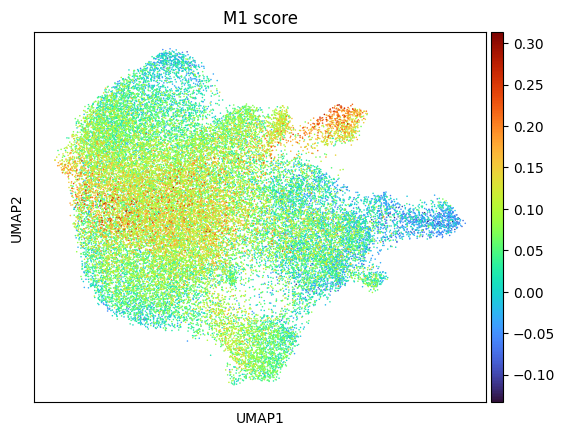

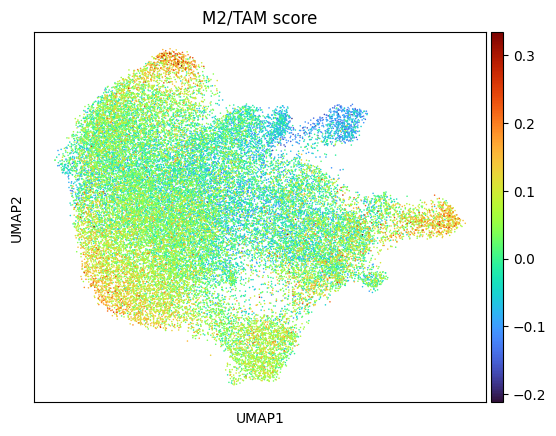

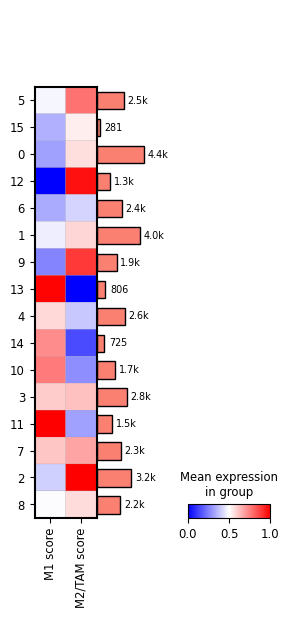

/mnt/disks/scratch/mbernstein/miniconda3/python3/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


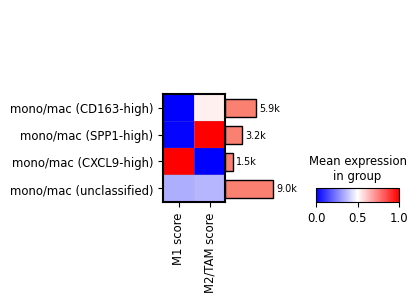

In [88]:
sc.tl.score_genes(adata_clust_1, m1_genes, score_name='M1 score')
sc.tl.score_genes(adata_clust_1, m2_tam_genes, score_name='M2/TAM score')

sc.pl.umap(adata_clust_1, color='M1 score', s=5, cmap='turbo')
sc.pl.umap(adata_clust_1, color='M2/TAM score', s=5, cmap='turbo')

sc.tl.dendrogram(adata_clust_1, groupby='leiden')
dp = sc.pl.matrixplot(
    adata_clust_1, 
    var_names=['M1 score', 'M2/TAM score'], 
    standard_scale='var',
    cmap='bwr',
    groupby='leiden', 
    dendrogram=True,
    return_fig=True
)
dp.add_totals().show()

adata_clust_1_plot = adata_clust_1[adata_clust_1.obs['clust1_cell_type'] == 'mono/mac']
sc.tl.dendrogram(adata_clust_1_plot, groupby='clust1_cell_subtype')
dp = sc.pl.matrixplot(
    adata_clust_1_plot, 
    var_names=['M1 score', 'M2/TAM score'], 
    standard_scale='var',
    cmap='bwr',
    groupby='clust1_cell_subtype', 
    dendrogram=True,
    return_fig=True
)
dp.add_totals().show()

## Explore Cluster 7 (pDC/B cell)

In [53]:
adata_clust_7 = adata[adata.obs['leiden'] == '7']
sc.pp.pca(adata_clust_7)
sc.pp.neighbors(adata_clust_7)
sc.tl.umap(adata_clust_7)
sc.tl.leiden(adata_clust_7, resolution=0.25)

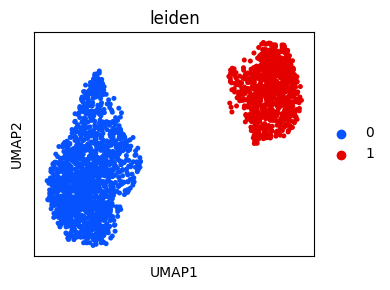

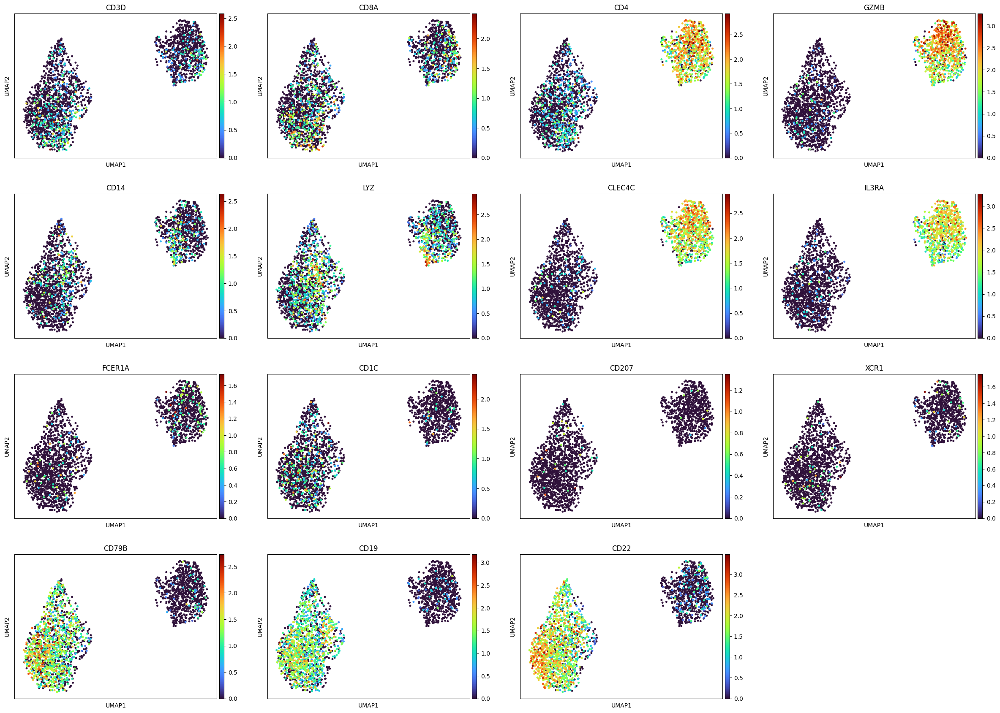

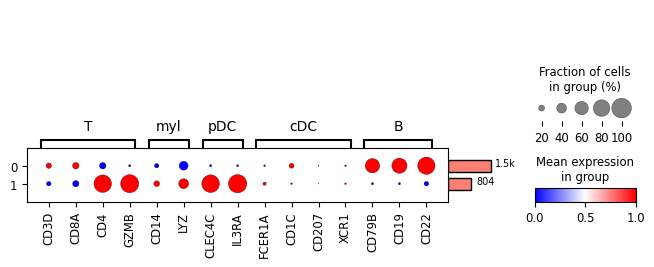

,0,1
0,MS4A1,IL3RA
1,TNFRSF13C,GZMB
2,CD79A,CLEC4C
3,CD22,DERL3
4,POU2AF1,CD4
5,CD19,TGFBI
6,CD79B,IRF4
7,CD40,VEGFB
8,PAX5,NRP1
9,BLK,EPHA2


In [54]:
fig, ax = plt.subplots(1,1,figsize=(4,3))
sc.pl.umap(
    adata_clust_7, 
    color=['leiden'],
    palette=MANY_COLORS,
    ax=ax,
    show=False
)
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_clusters_C7.png', dpi=200, format='png')

PLOT_GENES = {
    'T': ['CD3D', 'CD8A', 'CD4', 'GZMB'], 
    'myl': ['CD14', 'LYZ'],
    'pDC': ['CLEC4C', 'IL3RA'],
    'cDC': ['FCER1A', 'CD1C', 'CD207', 'XCR1'],
    'B': ['CD79B', 'CD19', 'CD22']
}

plot_genes = []
for genes in PLOT_GENES.values():
    plot_genes += genes
sc.pl.umap(adata_clust_7, color=plot_genes, cmap='turbo', s=50)

dp = sc.pl.dotplot(
    adata_clust_7, 
    var_names=PLOT_GENES, 
    standard_scale='var',
    cmap='bwr',
    groupby='leiden', 
    return_fig=True
)
dp.add_totals().show()

clust_to_de_genes = {}
sc.tl.rank_genes_groups(adata_clust_7, groupby='leiden', method='wilcoxon')
for clust in sorted(set(adata_clust_7.obs['leiden'])):
    df_de = sc.get.rank_genes_groups_df(adata_clust_7, group=clust)
    de_genes = df_de[:25]['names']
    clust_to_de_genes[clust] = de_genes

df_de = pd.DataFrame(
    data=clust_to_de_genes
)
display(df_de)

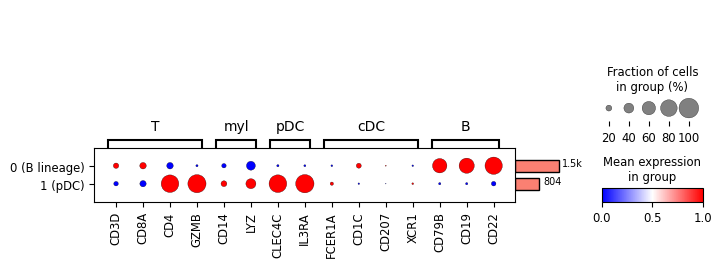

<Figure size 640x480 with 0 Axes>

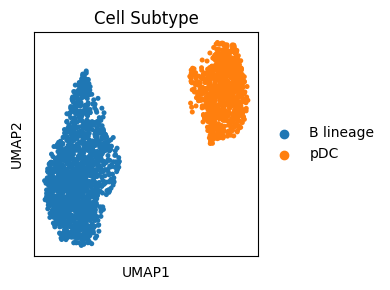

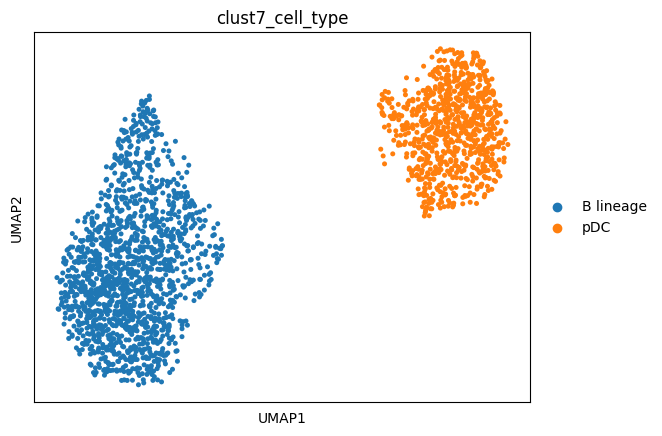

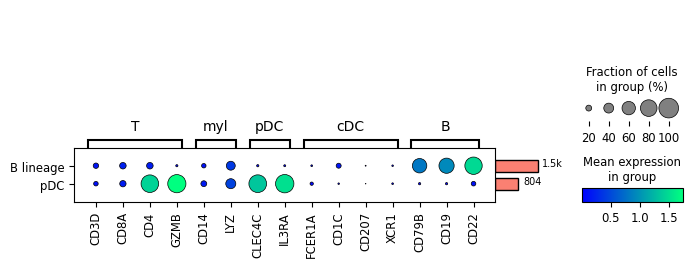

In [55]:
CLUST7_CLUST_TO_CELL_TYPE = {
    '0': 'B lineage', 
    '1': 'pDC'
}

CLUST7_CLUST_TO_CELL_SUBTYPE = {
    '0': 'B lineage', 
    '1': 'pDC'
}

# Create dotplot with renamed clusters
adata_clust_7.obs['Cluster'] = [
    f'{clust} ({CLUST7_CLUST_TO_CELL_SUBTYPE[clust]})'
    for clust in adata_clust_7.obs['leiden']
]
adata_clust_7.obs['Cluster'] = adata_clust_7.obs['Cluster'].astype('category')
sc.tl.dendrogram(adata_clust_7, groupby='Cluster')
dp = sc.pl.dotplot(
    adata_clust_7, 
    var_names=PLOT_GENES, 
    groupby='Cluster', 
    standard_scale='var',
    cmap='bwr',
    return_fig=True
)
dp.add_totals().show()
plt.tight_layout()
dp.fig.savefig(
    './output/publication_figures/dotplot_clusters_C7.png', 
    dpi=200, format='png', bbox_inches='tight'
)


clust7_cell_to_cell_type = {
    cell: CLUST7_CLUST_TO_CELL_TYPE[clust]
    for cell, clust in zip(adata_clust_7.obs.index, adata_clust_7.obs['leiden'])
}
adata_clust_7.obs['clust7_cell_type'] = [
    clust7_cell_to_cell_type[cell]
    for cell in adata_clust_7.obs.index
]

clust7_cell_to_cell_subtype = {
    cell: CLUST7_CLUST_TO_CELL_SUBTYPE[clust]
    for cell, clust in zip(adata_clust_7.obs.index, adata_clust_7.obs['leiden'])
}
adata_clust_7.obs['clust7_cell_subtype'] = [
    clust7_cell_to_cell_subtype[cell]
    for cell in adata_clust_7.obs.index
]

fig, ax = plt.subplots(1,1,figsize=(4,3))
sc.pl.umap(
    adata_clust_7, 
    color=['clust7_cell_type'],
    ax=ax,
    palette=sns.color_palette(),
    show=False
)
ax.set_title('Cell Subtype')
plt.tight_layout()
fig.savefig('./output/publication_figures/umap_subtype_C7.png', dpi=200, format='png')

sc.pl.umap(adata_clust_7, color='clust7_cell_type')
dp = sc.pl.dotplot(
    adata_clust_7, 
    var_names=PLOT_GENES, 
    groupby='clust7_cell_type', 
    return_fig=True
)
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

## Label cells

categories: B lineage, CD4 T, CD8 T, etc.
var_group_labels: T cell, CD8 T, CD4 T, etc.


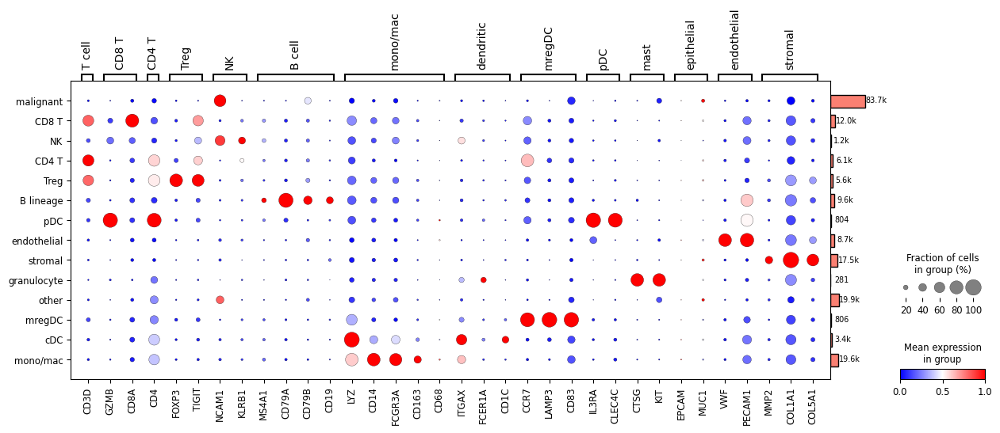

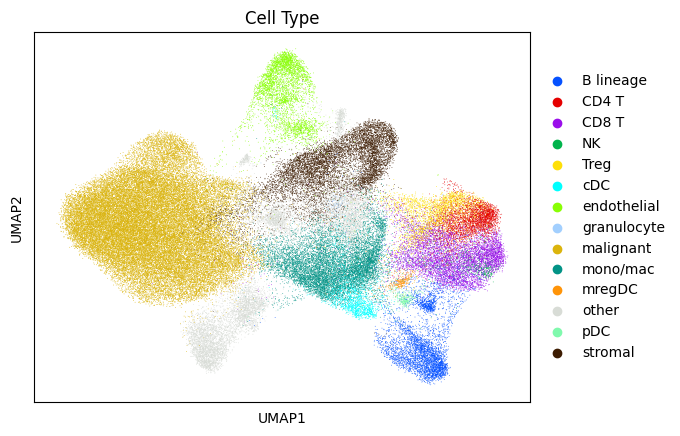

categories: B lineage, CD4 T (DC interaction), CD4 T (Tcm), etc.
var_group_labels: T cell, CD8 T, CD4 T, etc.


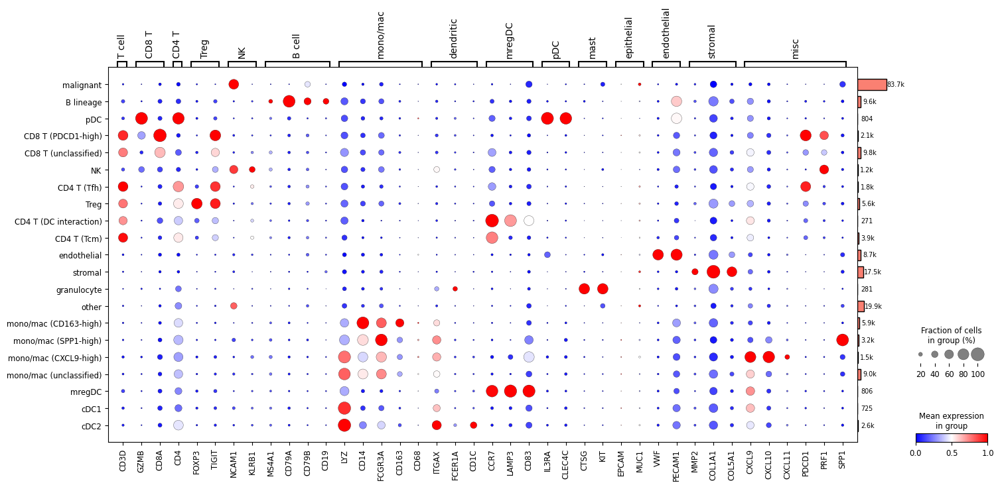

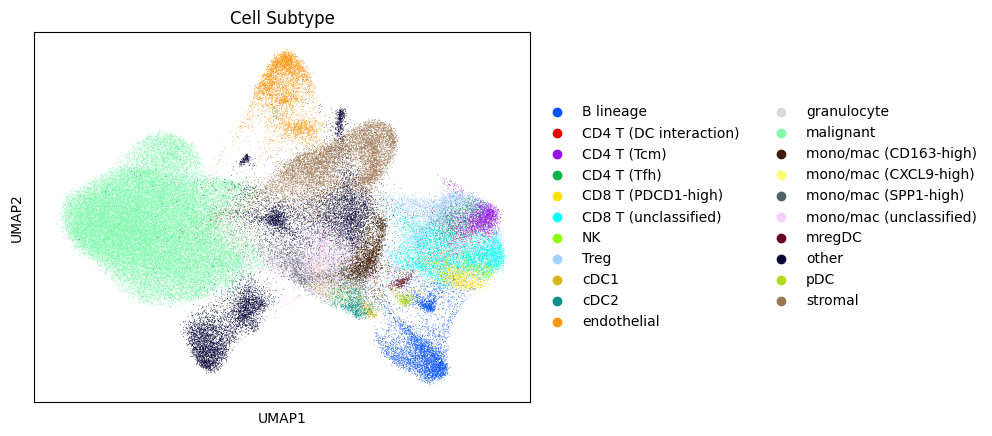

In [78]:
labels = []
for cell, clust in zip(adata.obs.index, adata.obs['leiden']):
    if cell in clust1_cell_to_cell_type:
        labels.append(clust1_cell_to_cell_type[cell])
    elif cell in clust2_cell_to_cell_type:
        labels.append(clust2_cell_to_cell_type[cell])
    elif cell in clust7_cell_to_cell_type:
        labels.append(clust7_cell_to_cell_type[cell])
    else:
        labels.append(FULL_CLUST_TO_CELL_TYPE[clust])
adata.obs['Cell Type'] = labels
adata.obs['Cell Type'] = adata.obs['Cell Type'].astype('category')

labels = []
for cell, clust in zip(adata.obs.index, adata.obs['leiden']):
    if cell in clust1_cell_to_cell_subtype:
        labels.append(clust1_cell_to_cell_subtype[cell])
    elif cell in clust2_cell_to_cell_subtype:
        labels.append(clust2_cell_to_cell_subtype[cell])
    elif cell in clust7_cell_to_cell_subtype:
        labels.append(clust7_cell_to_cell_subtype[cell])
    else:
        labels.append(FULL_CLUST_TO_CELL_TYPE[clust])
adata.obs['Cell Subtype'] = labels
adata.obs['Cell Subtype'] = adata.obs['Cell Subtype'].astype('category')


sc.tl.dendrogram(adata, groupby='Cell Type')
dp = sc.pl.dotplot(
    adata, 
    var_names={
        'T cell': [
            'CD3D'
        ],
        'CD8 T': [
            'GZMB',
            'CD8A'
        ],
        'CD4 T': [
            'CD4'
        ],
        'Treg': [
            'FOXP3', 
            'TIGIT'
        ],
        'NK': [
            'NCAM1', 
            'KLRB1'
        ],
        'B cell': [
            'MS4A1',
            'CD79A',
            'CD79B',
            'CD19'
        ],
        'mono/mac': [
            'LYZ', 
            'CD14', 
            'FCGR3A', 
            'CD163',
            'CD68'
        ],
        'dendritic': [
            'ITGAX',
            'FCER1A',
            'CD1C'
        ],
        'mregDC': [
            'CCR7',
            'LAMP3',
            'CD83'
        ],
        'pDC': [
            'IL3RA',
            'CLEC4C'
            #LILRA4
            #PLD4  
        ],
        'mast': [
            'CTSG',
            'KIT'
        ],
        'epithelial': [
            'EPCAM',
            'MUC1'
        ],
        'endothelial': [
            'VWF', 
            'PECAM1'
        ],
        'stromal': [
            'MMP2',
            'COL1A1',
            'COL5A1'
        ]
    },
    groupby=['Cell Type'],
    standard_scale='var',
    cmap='bwr',
    dendrogram=True,
    return_fig=True
)
dp.add_totals().show()



adata_sub.obs['Cell Type'] = adata.obs.loc[adata_sub.obs.index]['Cell Type']
sc.pl.umap(adata_sub, color='Cell Type', palette=MANY_COLORS)
plt.show()




sc.tl.dendrogram(adata, groupby='Cell Subtype')
dp = sc.pl.dotplot(
    adata, 
    var_names={
        'T cell': [
            'CD3D'
        ],
        'CD8 T': [
            'GZMB',
            'CD8A'
        ],
        'CD4 T': [
            'CD4'
        ],
        'Treg': [
            'FOXP3', 
            'TIGIT'
        ],
        'NK': [
            'NCAM1', 
            'KLRB1'
        ],
        'B cell': [
            'MS4A1',
            'CD79A',
            'CD79B',
            'CD19'
        ],
        'mono/mac': [
            'LYZ', 
            'CD14', 
            'FCGR3A', 
            'CD163',
            'CD68'
        ],
        'dendritic': [
            'ITGAX',
            'FCER1A',
            'CD1C'
        ],
        'mregDC': [
            'CCR7',
            'LAMP3',
            'CD83'
        ],
        'pDC': [
            'IL3RA',
            'CLEC4C'
            #LILRA4
            #PLD4  
        ],
        'mast': [
            'CTSG',
            'KIT'
        ],
        'epithelial': [
            'EPCAM',
            'MUC1'
        ],
        'endothelial': [
            'VWF', 
            'PECAM1'
        ],
        'stromal': [
            'MMP2',
            'COL1A1',
            'COL5A1'
        ],
        'misc': [
            'CXCL9',
            'CXCL10',
            'CXCL11',
            'PDCD1',
            'PRF1',
            'SPP1'
        ]
    },
    groupby=['Cell Subtype'],
    standard_scale='var',
    cmap='bwr',
    dendrogram=True,
    return_fig=True
)
dp.add_totals().show()



adata_sub.obs['Cell Subtype'] = adata.obs.loc[adata_sub.obs.index]['Cell Subtype']
sc.pl.umap(adata_sub, color='Cell Subtype', palette=MANY_COLORS)
plt.show()

In [79]:
adata.write_h5ad('./output/HumanMelanomaPatient2_labeled.h5ad')
adata_sub.write_h5ad('./output/HumanMelanomaPatient2_subset_labeled.h5ad')